In [12]:
import numpy as np
import matplotlib.pyplot as plt
import cv2 as cv
from google.colab.patches import cv2_imshow
import tensorflow as tf
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
import sklearn.datasets as sk
import sklearn.manifold as skmodel

!pip uninstall umap
!pip install umap-learn
from umap import UMAP

# Principle Component Analysis

In [13]:
class PCA:
  def __init__(self, ncomponents):
    self.npca = ncomponents

  def run(self, data):
    N, D = data.shape

    self.X = data
    self.cov = (self.X.T @ self.X) / N

    self.value, self.vector = np.linalg.eig(self.cov)

    self.Q = self.vector[:, :self.npca]

    # return N x nPCA
    return self.X @ self.Q

  def reverse(self, pca_data):
    # gives back data with information loss
    # return N x D
    return pca_data @ self.Q.T

  # gives IL in percentage
  def information_loss(self):
    return float(1 - np.sum((self.value[:self.npca]))/np.sum(self.value))*100

# tSNE (T-Distributed Stochastic Neighbour Embedding)

In [14]:
# See https://nlml.github.io/in-raw-numpy/in-raw-numpy-t-sne/
class SNE:
  def __init__(self, perplexity, is_tsne=False, num_iters=500, learning_rate=10., 
               momentum=0., num_plots=5, verbose=False, graphing=False):
    self.perp = perplexity
    self.epoch = num_iters
    self.lr = learning_rate
    self.momentum = momentum
    self.num_plots = num_plots
    self.is_tsne = is_tsne
    self.graphing = graphing
    self.verbose = verbose

  def neg_squared_euc_dists(self, X):
    """Compute matrix containing negative squared euclidean
    distance for all pairs of points in input matrix X

    # Arguments:
        X: matrix of size NxD
    # Returns:
        NxN matrix D, with entry D_ij = negative squared
        euclidean distance between rows X_i and X_j
    """
    # Math? See https://stackoverflow.com/questions/37009647
    sum_X = np.sum(np.square(X), 1)
    D = np.add(np.add(-2 * np.dot(X, X.T), sum_X).T, sum_X)
    return -D

  def softmax(self, X, diag_zero=True):
    """Take softmax of each row of matrix X."""

    # Subtract max for numerical stability
    e_x = np.exp(X - np.max(X, axis=1).reshape([-1, 1]))

    # We usually want diagonal probailities to be 0.
    if diag_zero:
        np.fill_diagonal(e_x, 0.)

    # Add a tiny constant for stability of log we take later
    e_x = e_x + 1e-8  # numerical stability

    return e_x / e_x.sum(axis=1).reshape([-1, 1])

  def calc_prob_matrix(self, distances, sigmas=None):
    """Convert a distances matrix to a matrix of probabilities."""
    if sigmas is not None:
      two_sig_sq = 2. * np.square(sigmas.reshape((-1, 1)))
      return self.softmax(distances / two_sig_sq)
    else:
      return self.softmax(distances)

  def binary_search(self, eval_fn, target, tol=1e-10, max_iter=10000, 
                    lower=1e-20, upper=1000.):
    """Perform a binary search over input values to eval_fn.
      
    # Arguments
        eval_fn: Function that we are optimising over.
        target: Target value we want the function to output.
        tol: Float, once our guess is this close to target, stop.
        max_iter: Integer, maximum num. iterations to search for.
        lower: Float, lower bound of search range.
        upper: Float, upper bound of search range.
    # Returns:
        Float, best input value to function found during search.
    """
    for i in range(max_iter):
        guess = (lower + upper) / 2.
        # print(distances.shape)
        val = eval_fn(guess)
        if val > target:
          upper = guess
        else:
          lower = guess
        if np.abs(val - target) <= tol:
          break
    return guess

  def calc_perplexity(self, prob_matrix):
    """Calculate the perplexity of each row 
    of a matrix of probabilities."""
    entropy = -np.sum(prob_matrix * np.log2(prob_matrix), 1)
    perplexity = 2 ** entropy
    # print("Row: ", i, " and perp: ", perplexity)
    return perplexity


  def perplexity(self, distances, sigmas):
    """Wrapper function for quick calculation of 
    perplexity over a distance matrix."""
    return self.calc_perplexity(self.calc_prob_matrix(distances, sigmas))

  # def eval_fn(self, sigma, distances, i):
  #   # print(distances.shape)
  #   # return self.perplexity(distances[i:i+1, :], np.array(sigma))
  #   return self.perplexity(distances[i, :], np.array(sigma))

  def find_optimal_sigmas(self, distances, target_perplexity):
    """For each row of distances matrix, find sigma that results
    in target perplexity for that role."""
    sigmas = [] 
    # print(distances.shape)
    # For each row of the matrix (each point in our dataset)
    for i in range(distances.shape[0]):
      # Make fn that returns perplexity of this row given sigma
      eval_fn = lambda sigma: \
            self.perplexity(distances[i:i+1, :], np.array(sigma))
          # Binary search over sigmas to achieve target perplexity
      # print("shape", distances.shape)
      correct_sigma = self.binary_search(eval_fn, target_perplexity)
      # Append the resulting sigma to our output array
      sigmas.append(correct_sigma)
    return np.array(sigmas)

  def q_joint(self, Y):
    """Given low-dimensional representations Y, compute
    matrix of joint probabilities with entries q_ij."""
    # Get the distances from every point to every other
    distances = self.neg_squared_euc_dists(Y)
    # Take the elementwise exponent
    exp_distances = np.exp(distances)
    # Fill diagonal with zeroes so q_ii = 0
    np.fill_diagonal(exp_distances, 0.)
    # Divide by the sum of the entire exponentiated matrix
    return exp_distances / np.sum(exp_distances), None


  def p_conditional_to_joint(self, P):
    """Given conditional probabilities matrix P, return
    approximation of joint distribution probabilities."""
    return (P + P.T) / (2. * P.shape[0])

  def p_joint(self, X):
    """Given a data matrix X, gives joint probabilities matrix.

    # Arguments
        X: Input data matrix.
    # Returns:
        P: Matrix with entries p_ij = joint probabilities.
    """
    target_perplexity = self.perp
    # Get the negative euclidian distances matrix for our data
    distances = self.neg_squared_euc_dists(X)
    # Find optimal sigma for each row of this distances matrix
    sigmas = self.find_optimal_sigmas(distances, target_perplexity)
    # Calculate the probabilities based on these optimal sigmas
    p_conditional = self.calc_prob_matrix(distances, sigmas)
    # Go from conditional to joint probabilities matrix
    P = self.p_conditional_to_joint(p_conditional)
    return P

  def symmetric_sne_grad(self, P, Q, Y, _):
    """Estimate the gradient of the cost with respect to Y"""
    pq_diff = P - Q  # NxN matrix
    pq_expanded = np.expand_dims(pq_diff, 2)  #NxNx1
    y_diffs = np.expand_dims(Y, 1) - np.expand_dims(Y, 0)  #NxNx2
    grad = 4. * (pq_expanded * y_diffs).sum(1)  #Nx2
    return grad
  
  def q_tsne(self, Y):
    """t-SNE: Given low-dimensional representations Y, compute
    matrix of joint probabilities with entries q_ij."""
    distances = self.neg_squared_euc_dists(Y)
    inv_distances = np.power(1. - distances, -1)
    np.fill_diagonal(inv_distances, 0.)
    q = inv_distances / np.sum(inv_distances)
    return inv_distances / np.sum(inv_distances), inv_distances

  def tsne_grad(self, P, Q, Y, inv_distances):
    """Estimate the gradient of t-SNE cost with respect to Y."""
    pq_diff = P - Q
    pq_expanded = np.expand_dims(pq_diff, 2)
    y_diffs = np.expand_dims(Y, 1) - np.expand_dims(Y, 0)
    # Expand our inv_distances matrix so can multiply by y_diffs
    distances_expanded = np.expand_dims(inv_distances, 2)

    # Multiply this by inverse distances matrix
    y_diffs_wt = y_diffs * distances_expanded

    # Multiply then sum over j's
    grad = 4. * (pq_expanded * y_diffs_wt).sum(1)

    return grad

  def fit_predict(self, X, y, P, rng, classes, dataset):
    """Estimates a SNE model.

    # Arguments
        X: Input data matrix.
        y: Class labels for that matrix.
        P: Matrix of joint probabilities.
        rng: np.random.RandomState().
        num_iters: Iterations to train for.
        q_fn: Function that takes Y and gives Q prob matrix.
        plot: How many times to plot during training.
    # Returns:
        Y: Matrix, low-dimensional representation of X.
    """
    q_fn = self.q_tsne if (self.is_tsne) else self.q_joint
    grad_fn = self.tsne_grad if (self.is_tsne) else self.symmetric_sne_grad

    # fig = plt.figure(figsize=(10, 8))

    # Initialise our 2D representation
    Y = rng.normal(0., 0.0001, [X.shape[0], 2])

    # Initialise past values (used for momentum)
    if self.momentum:
      Y_m2 = Y.copy()
      Y_m1 = Y.copy()

    # if (self.graphing):
    #   # plt.ion()
    #   fig= plt.figure(figsize=(20, 10))
      # Start gradient descent loop
    for i in range(self.epoch):
      # Get Q and distances (distances only used for t-SNE)
      Q, distances = q_fn(Y)

      # Estimate gradients with respect to Y
      grads = grad_fn(P, Q, Y, distances)

      # Update Y
      Y = Y - self.lr * grads
      if self.momentum:  # Add momentum
        Y += self.momentum * (Y_m1 - Y_m2)
        # Update previous Y's for momentum
        Y_m2 = Y_m1.copy()
        Y_m1 = Y.copy()
      
      norm_grad = np.linalg.norm(grads, axis=0)
      if (self.verbose):
        if (self.is_tsne): print("Epoch %d with norm of tsne1 = %f and tsne2 = %f" % (i, norm_grad[0], norm_grad[1]))
        else : print("Epoch %d with norm of sne1 = %f and sne2 = %f" % (i, norm_grad[0], norm_grad[1]))
      
      if (self.graphing):
        if (i%(self.epoch/self.num_plots)==0):
          fig = plt.figure(figsize=(20, 10))
          method = "tSNE" if self.is_tsne else "SNE"
          xlabel = "tSNE1" if self.is_tsne else "SNE1"
          ylabel = "tSNE2" if self.is_tsne else "SNE2"

          for label in range(np.max(y)+1):
            plt.scatter(Y[y==label, 0], Y[y==label, 1], label=str(classes[label]))
          plt.title("%s Graph for %s dataset after %d iterations" % (method, dataset, i), fontsize=25)
          plt.xlabel(xlabel, fontsize=15)
          plt.ylabel(ylabel, fontsize=15)
          plt.legend(loc="upper left")
          plt.draw()
          plt.pause(0.001)
          fig.clear()

    return Y

# Main Code

## Importing Data


### MNIST Dataset

Data size:  (60000, 28, 28)
Classes size:  (60000,)
Total Classes:  10
['0', '1', '2', '3', '4', '5', '6', '7', '8', '9']


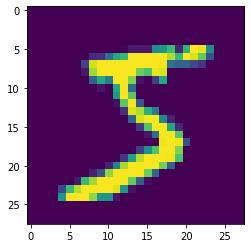

In [15]:
(mnist_x_train, mnist_y_train), (mnist_x_test, mnist_y_test) = tf.keras.datasets.mnist.load_data()
MNIST_CLASSES = []
for i in range(10):
  MNIST_CLASSES.append(str(i))
print("Data size: ", mnist_x_train.shape)
print("Classes size: ", mnist_y_train.shape)
print("Total Classes: ", np.max(mnist_y_train)+1)
print(MNIST_CLASSES)

plt.imshow(mnist_x_train[0])

mnist_x_train = mnist_x_train.reshape(mnist_x_train.shape[0], -1) # Vector format
# print(mnist_x_train.shape)

### Fashion MNIST Dataset

Data size:  (60000, 28, 28)
Classes:  (60000,)
Total Classes:  10
['T-shirt/top', 'Trouser', 'Pullover', 'Dress', 'Coat', 'Sandal', 'Shirt', 'Sneaker', 'Bag', 'Ankle boot']


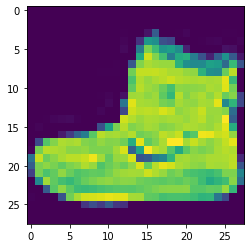

In [16]:
(fashion_mnist_x_train, fashion_mnist_y_train), (fashion_mnist_x_test, fashion_mnist_y_test) = tf.keras.datasets.fashion_mnist.load_data()
FASHION_MNIST_CLASSES = ["T-shirt/top", "Trouser", "Pullover", "Dress", "Coat", "Sandal", "Shirt", "Sneaker", "Bag", "Ankle boot"]
print("Data size: ", fashion_mnist_x_train.shape)
print("Classes: ", fashion_mnist_y_train.shape)
print("Total Classes: ", np.max(mnist_y_train)+1)
print(FASHION_MNIST_CLASSES)

plt.imshow(fashion_mnist_x_train[0])
fashion_mnist_x_train = fashion_mnist_x_train.reshape(fashion_mnist_x_train.shape[0], -1) # Vector format
# print(fashion_mnist_x_train.shape)

### Olivetti Faces Dataset

Data:  (400, 4096)
Classes:  (400,)
Total Classes:  40
['Person 1', 'Person 2', 'Person 3', 'Person 4', 'Person 5', 'Person 6', 'Person 7', 'Person 8', 'Person 9', 'Person 10', 'Person 11', 'Person 12', 'Person 13', 'Person 14', 'Person 15', 'Person 16', 'Person 17', 'Person 18', 'Person 19', 'Person 20', 'Person 21', 'Person 22', 'Person 23', 'Person 24', 'Person 25', 'Person 26', 'Person 27', 'Person 28', 'Person 29', 'Person 30', 'Person 31', 'Person 32', 'Person 33', 'Person 34', 'Person 35', 'Person 36', 'Person 37', 'Person 38', 'Person 39', 'Person 40']


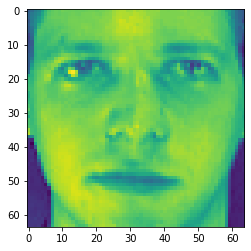

In [17]:
(olivetti_x, olivetti_y) = sk.fetch_olivetti_faces(return_X_y=True)
OLIVETTI_CLASSES = []
for i in range(np.max(olivetti_y)+1):
  OLIVETTI_CLASSES.append("Person "+str(i+1))
print("Data: ", olivetti_x.shape) # values under 1
print("Classes: ", olivetti_y.shape)
print("Total Classes: ", np.max(olivetti_y)+1)
print(OLIVETTI_CLASSES)
plt.imshow(olivetti_x[0].reshape(64, 64))

### COIL-20 Dataset
***Decided to opt-out of COIL-20 Dataset as eigen decomposition for the dataset was computationally expensive***

In [18]:
# coil20_x = []
# coil20_y = []
# for i in range(1440):
#   # filename = "\\coil-20\\obj"+str(int(i/72+1))+"__"+str(i%72)+".png"
#   filename = "obj"+str(int(i/72+1))+"__"+str(i%72)+".png"
#   # print(filename)
#   coil20_raw = plt.imread("/content/coil20/%s"%filename)
#   coil20_x.append(coil20_raw)
#   coil20_y.append(int(i/72))
# coil20_x = np.array(coil20_x, dtype=float)
# coil20_y = np.array(coil20_y, dtype=int)
# # print(coil20_x.shape)
# # plt.imshow(coil20_x[0])

# COIL20_CLASSES = []
# for i in range(np.max(coil20_y)+1):
#   COIL20_CLASSES.append(str("Object "+str(i+1)))

# print("Data size: ", coil20_x.shape)
# print("Classes: ", coil20_y.shape)
# print("Total Classes: ", np.max(coil20_y)+1)
# print(COIL20_CLASSES)
# plt.imshow(coil20_x[0])

# coil20_x = coil20_x.reshape(coil20_x.shape[0], -1) # Vector format
# print(coil20_x.shape)

## Standard Graphing

In [19]:
def graph_2d(x1, y1, y1_classes, method1, dataset):
  assert (x1.shape[0]==y1.shape[0] and np.max(y1)+1==len(y1_classes))

  fig = plt.figure(figsize=(20, 10))
  for i in range(np.max(y1)+1):
    plt.scatter(x1[y1==i, 0], x1[y1==i, 1], label=str(y1_classes[i]))
  plt.title("%s Final Visualization on %s Dataset"%(method1, dataset), fontsize=40)
  plt.xlabel("%s1"%method1, fontsize=20)
  plt.ylabel("%s2"%method1, fontsize=20)
  plt.legend(loc="best")
  plt.show()

## Standard Graphing technique used for side-by-side comparison

In [20]:
def graph_comparison(x1, y1, y1_classes, method1, x2, y2, y2_classes, method2, dataset):
  assert (x1.shape[0]==y1.shape[0] and np.max(y1)+1==len(y1_classes) and 
          x2.shape[0]==y2.shape[0] and np.max(y2)+1==len(y2_classes))
  fig, ax = plt.subplots(2, 1, figsize=(20, 30))

  for i in range(np.max(y1)+1):
    ax[0].scatter(x1[y1==i, 0], x1[y1==i, 1], label=str(y1_classes[i]))
  ax[0].set_title("%s Graph on %s Dataset"%(method1, dataset), fontsize=30)
  ax[0].set_xlabel("%s1"%method1, fontsize=20)
  ax[0].set_ylabel("%s2"%method1, fontsize=20)
  ax[0].legend(loc="best")

  for i in range(np.max(y2)+1):
    ax[1].scatter(x2[y2==i, 0], x2[y2==i, 1], label=str(y2_classes[i]))
  ax[1].set_title("%s Graph on %s Dataset"%(method2, dataset), fontsize=30)
  ax[1].set_xlabel("%s1"%method2, fontsize=20)
  ax[1].set_ylabel("%s2"%method2, fontsize=20)
  ax[1].legend(loc="best")

  fig.suptitle("%s VS %s on %s Dataset"%(method1, method2, dataset), fontsize=40)
  # fig.tight_layout()

  plt.show()


## Using PCA to reduce High-Dimension data to 30-Dimension
* Firstly we extract 2% of MNIST and Fashion MNIST dataset
* This is needed due to limited computational power
* Normalize the data by constraining to [0, 1]

In [21]:
fraction = 0.02
N = mnist_x_train.shape[0]
mnist_x_train = mnist_x_train[:int(N*fraction)]
mnist_y_train = mnist_y_train[:int(N*fraction)]

fashion_mnist_x_train = fashion_mnist_x_train[:int(N*fraction)]
fashion_mnist_y_train = fashion_mnist_y_train[:int(N*fraction)]

# coil20_x = coil20_x[:int(0.5*coil20_x.shape[0])]
# coil20_y = coil20_y[:int(0.5*coil20_y.shape[0])]

In [22]:
mnist_x_train = mnist_x_train/float(np.max(mnist_x_train))
fashion_mnist_x_train = fashion_mnist_x_train/float(np.max(fashion_mnist_x_train))
olivetti_x = olivetti_x/float(np.max(olivetti_x))
# coil20_x = coil20_x/float(np.max(coil20_x))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: ComplexWarning: Casting complex values to real discards the imaginary part
  import sys


MNIST Data Shape:  (1200, 30)


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: ComplexWarning: Casting complex values to real discards the imaginary part


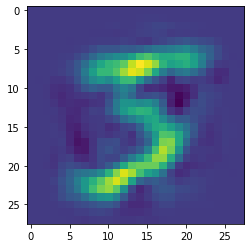

Fashion MNIST Data Shape:  (1200, 30)


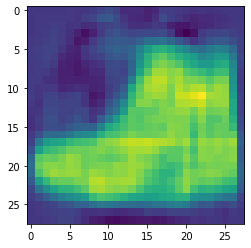

Olivetti Faces Data Shape:  (400, 30)


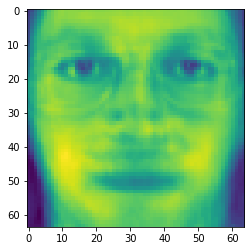

In [23]:
pca30_mnist = PCA(30) # mentioned in paper
pca30_fmnist = PCA(30)
pca30_olivetti = PCA(30)
# pca30_coil20 = PCA(30)

# for mnist convert complex to float
mnist_x_pca = np.array(pca30_mnist.run(mnist_x_train), dtype=float) # 4,704,000 pixels CHANGE THIS
fashion_mnist_x_pca = pca30_fmnist.run(fashion_mnist_x_train) # 4,704,000 pixels CHANGE THIS
olivetti_x_pca = pca30_olivetti.run(olivetti_x) # 1,638,400 pixels
# coil20_x_pca = pca30_coil20.run(coil20_x) # 50% of 23,592,960 pixels

# print("MNIST Data Shape: ", mnist_x_pca.shape)
# temp = pca30_mnist.reverse(mnist_x_pca)
# plt.imshow(temp[0].reshape(28, 28))
# plt.pause(0.001)

print("MNIST Data Shape: ", mnist_x_pca.shape)
temp = np.array(pca30_mnist.reverse(mnist_x_pca), dtype=float)
plt.imshow(temp[0].reshape(28, 28))
plt.pause(0.001)

print("Fashion MNIST Data Shape: ", fashion_mnist_x_pca.shape)
temp = pca30_fmnist.reverse(fashion_mnist_x_pca)
plt.imshow(temp[0].reshape(28, 28))
plt.pause(0.001)

print("Olivetti Faces Data Shape: ", olivetti_x_pca.shape)
temp = pca30_olivetti.reverse(olivetti_x_pca)
plt.imshow(temp[0].reshape(64, 64))
plt.pause(0.001)

# print("COIL-20 Data Shape: ", coil20_x_pca.shape)
# temp = pca30_coil20.reverse(coil20_x_pca)
# plt.imshow(temp[0].reshape(128, 128))
# plt.pause(0.001)

## Stochastic Neighbouring Embedding (SNE)
* Purpose is to show overall converging process for and how the datapoints are visually separating
* We'll be considering Fashion MNIST and Olivetti Faces Dataset for this example

### Fashion MNIST Dataset

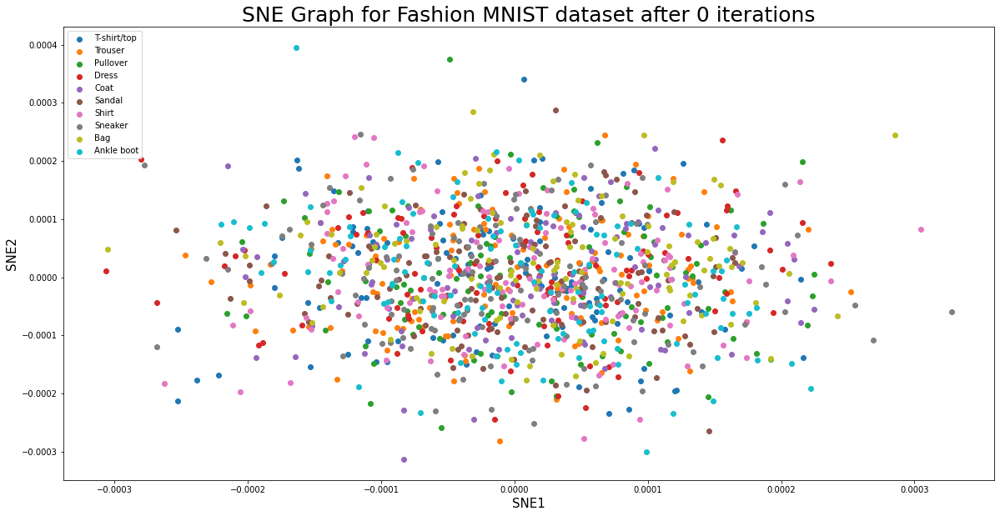

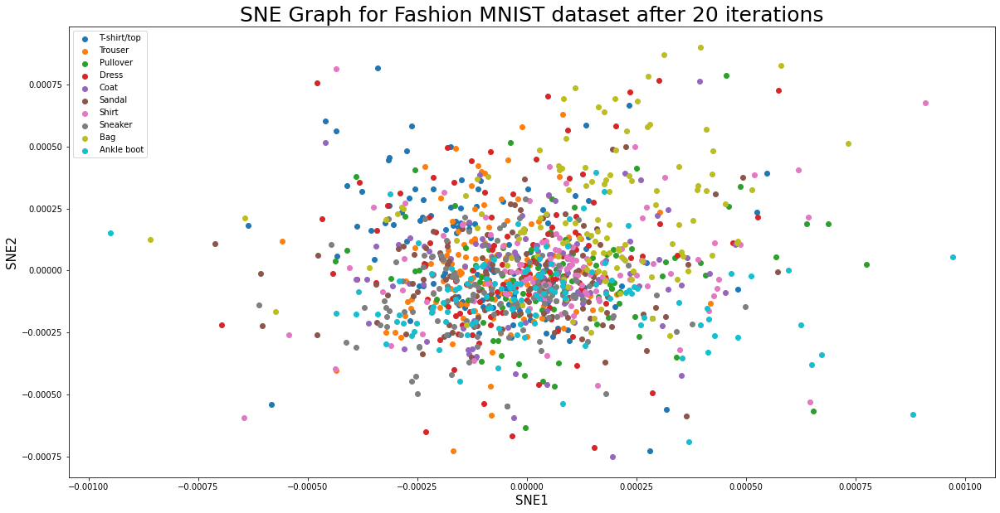

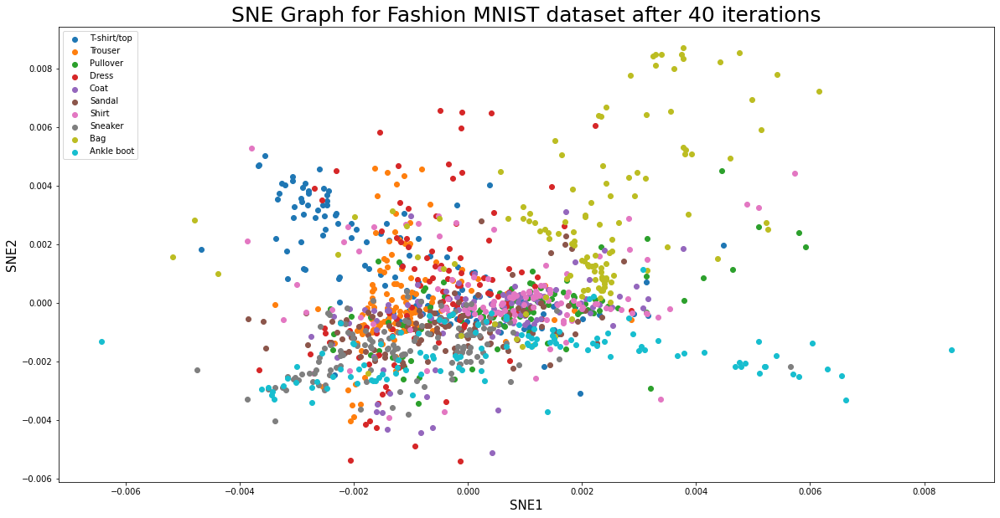

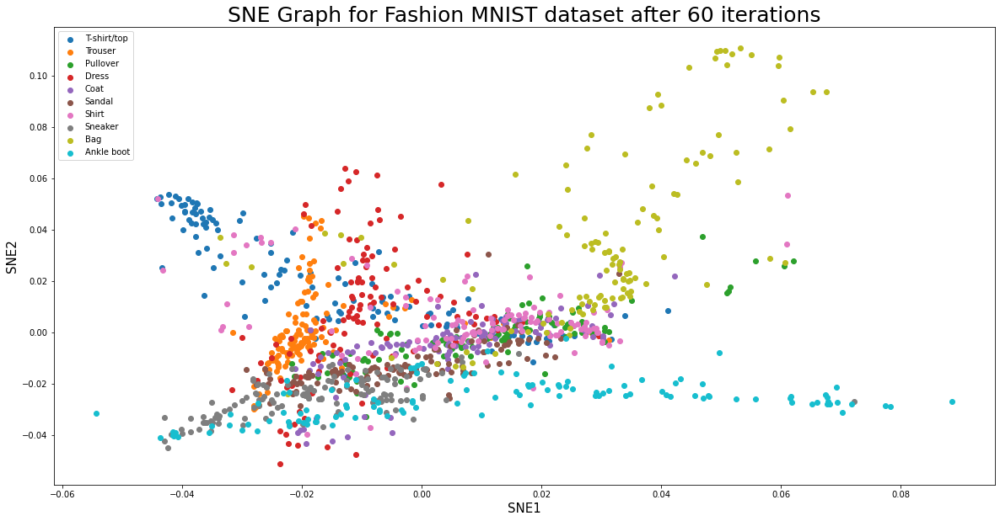

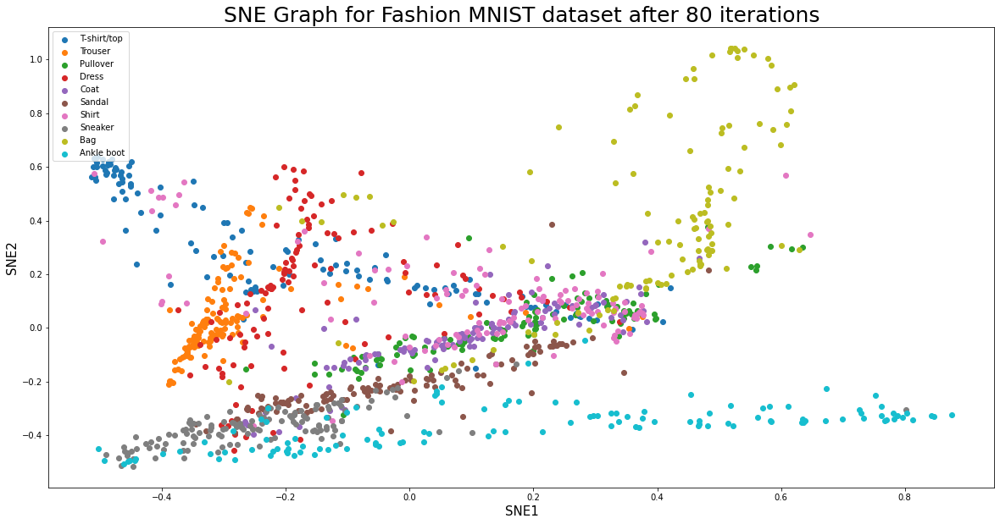

...

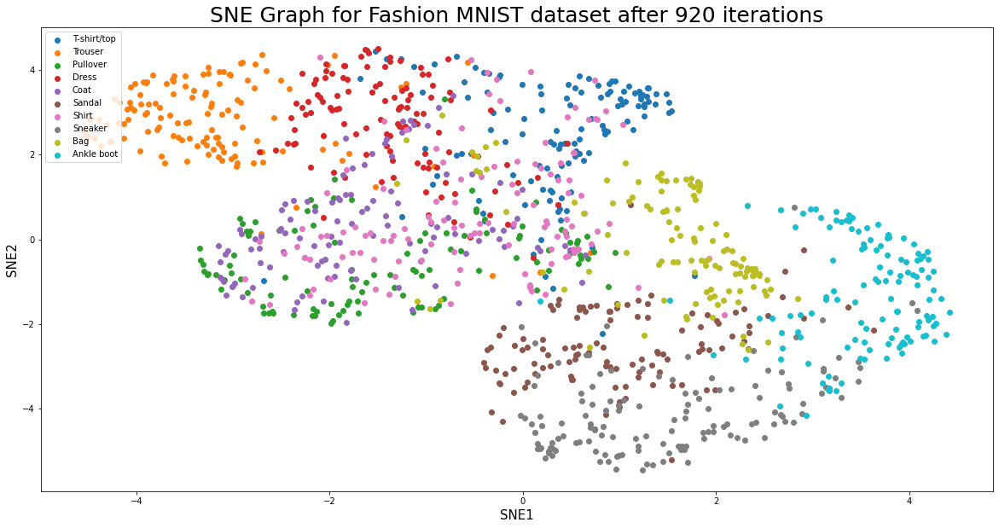

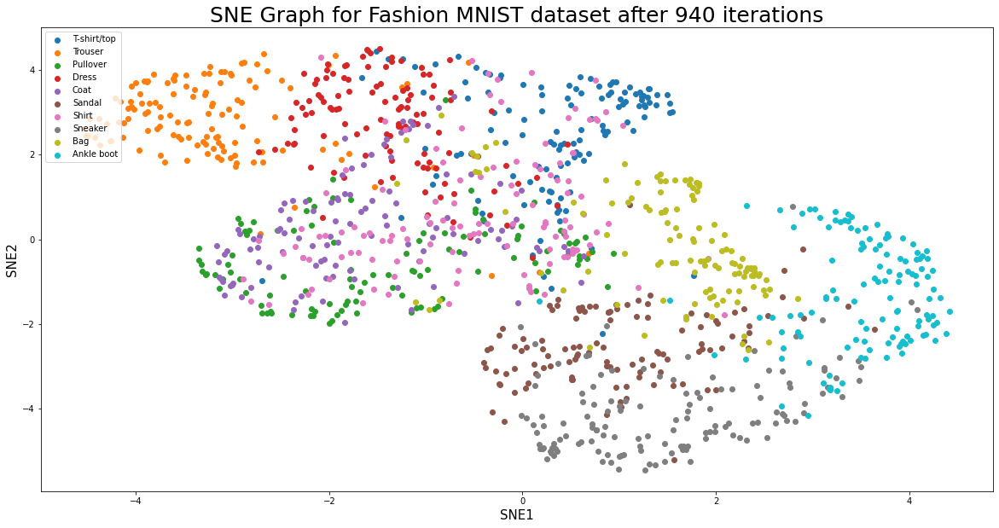

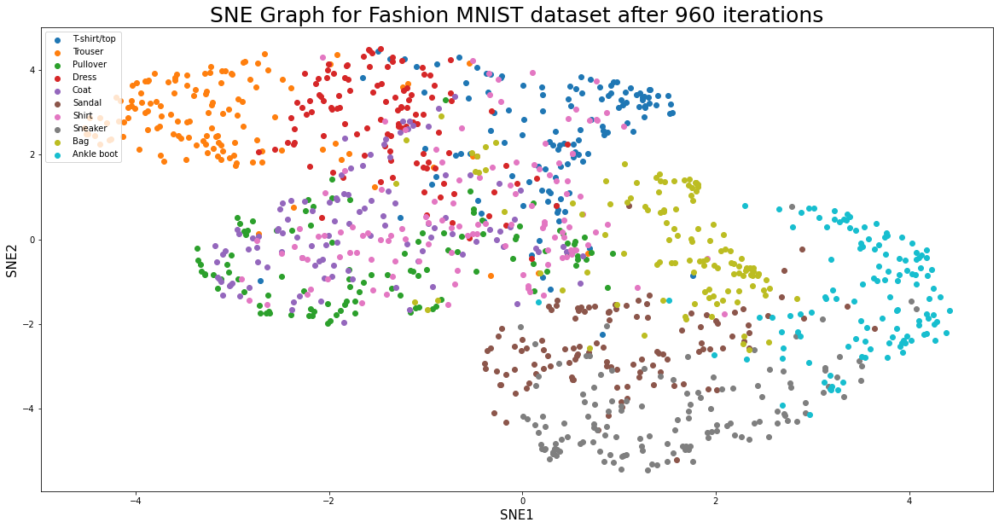

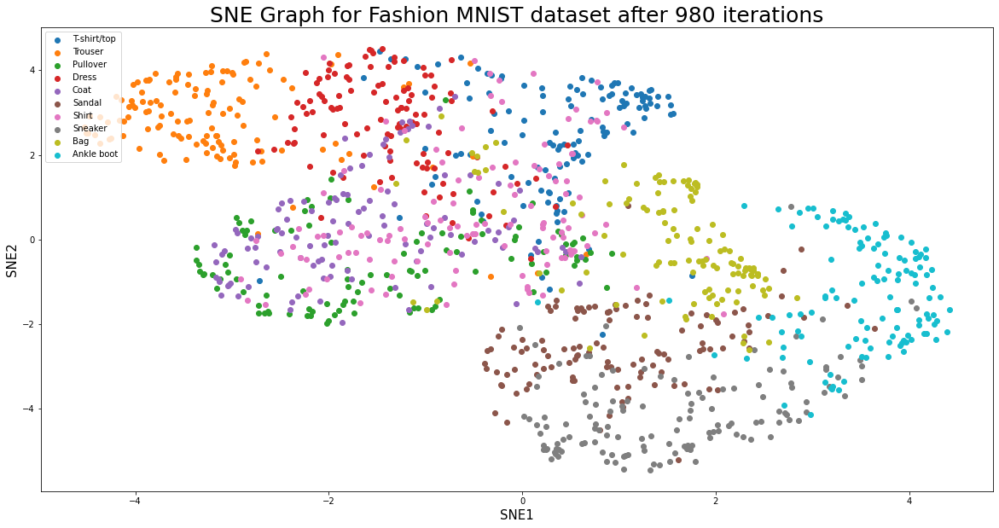

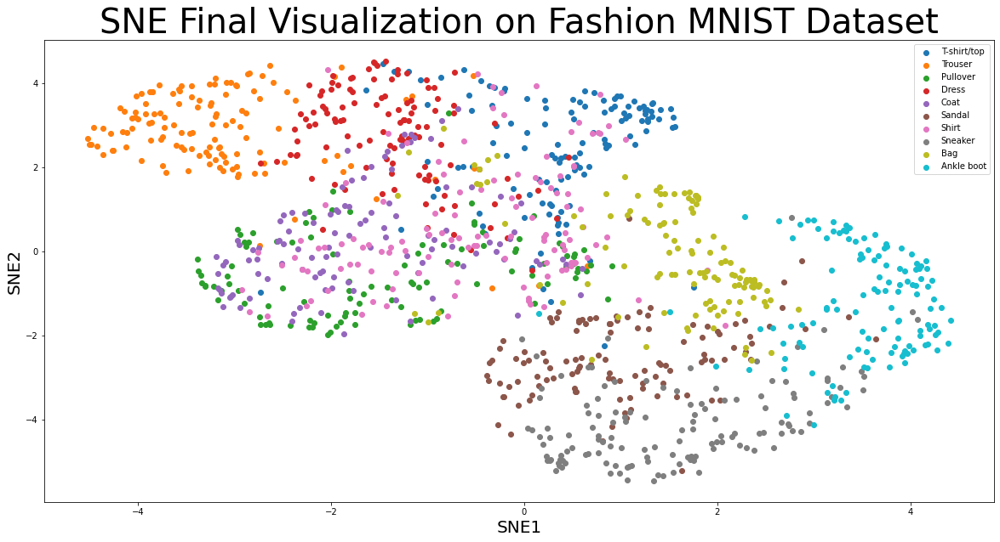

In [24]:
PERPLEXITY = 40
SEED = 1                    # Random seed
MOMENTUM = 0.9
LEARNING_RATE = 10.
NUM_ITERS = 1000            # Num iterations to train for
TSNE = False                # If False, Symmetric SNE
NUM_PLOTS = 50               # Num. times to plot in training
GRAPHING=True
VERBOSE=False

# numpy RandomState for reproducibility
rng = np.random.RandomState(SEED)

model_sne = SNE(PERPLEXITY, is_tsne=TSNE, num_iters=NUM_ITERS, 
            learning_rate=LEARNING_RATE, momentum=MOMENTUM,
            num_plots=NUM_PLOTS, graphing=GRAPHING, verbose=VERBOSE)

# FASHION MNIST DATASET
x_sne_fmnist = np.copy(fashion_mnist_x_pca)
y_sne_fmnist = np.copy(fashion_mnist_y_train)
# Obtain matrix of joint probabilities p_ij
p_sne_fmnist = model_sne.p_joint(x_sne_fmnist)

x_sne_fmnist_reduced = model_sne.fit_predict(x_sne_fmnist, y_sne_fmnist, p_sne_fmnist, rng, FASHION_MNIST_CLASSES, "Fashion MNIST")

graph_2d(x_sne_fmnist_reduced, y_sne_fmnist, FASHION_MNIST_CLASSES, "SNE", "Fashion MNIST")

### Olivetti Dataset

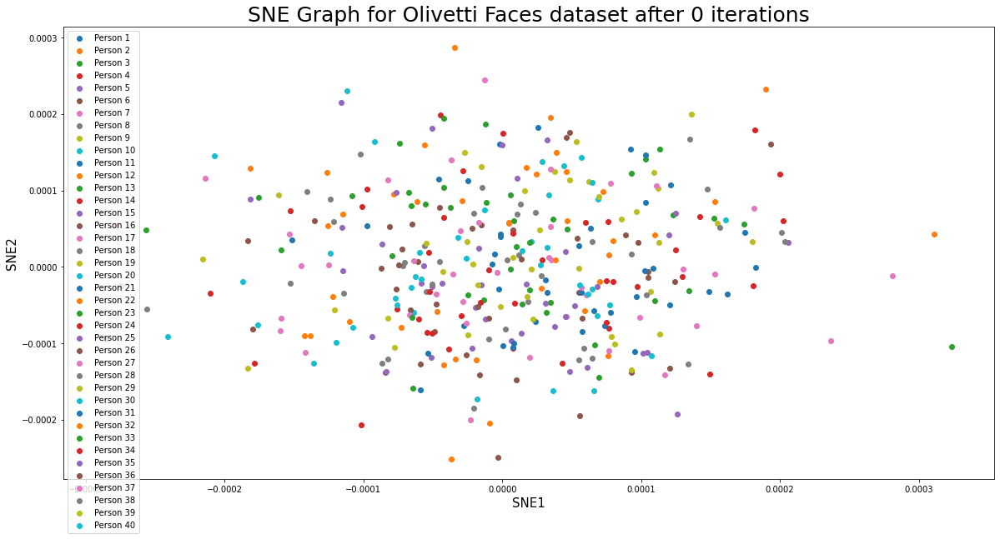

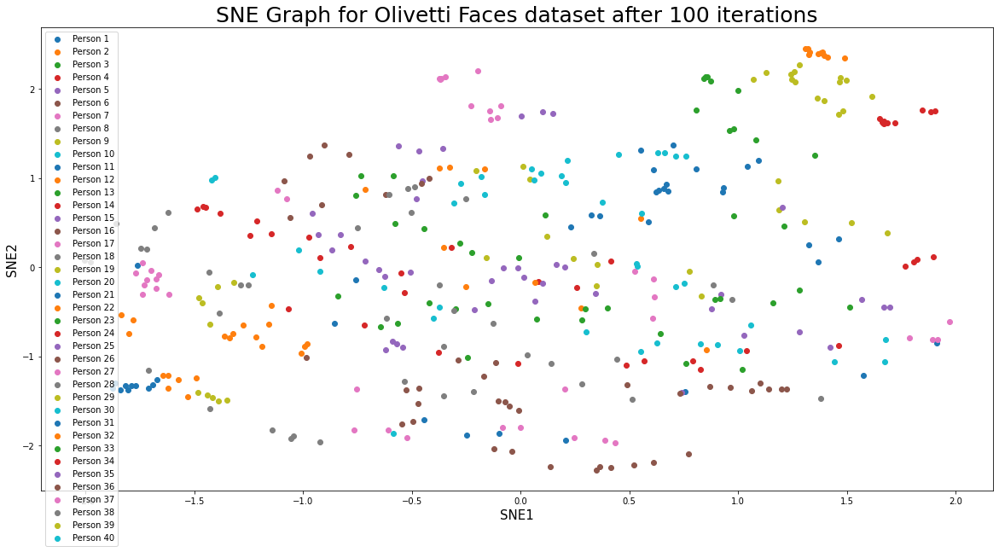

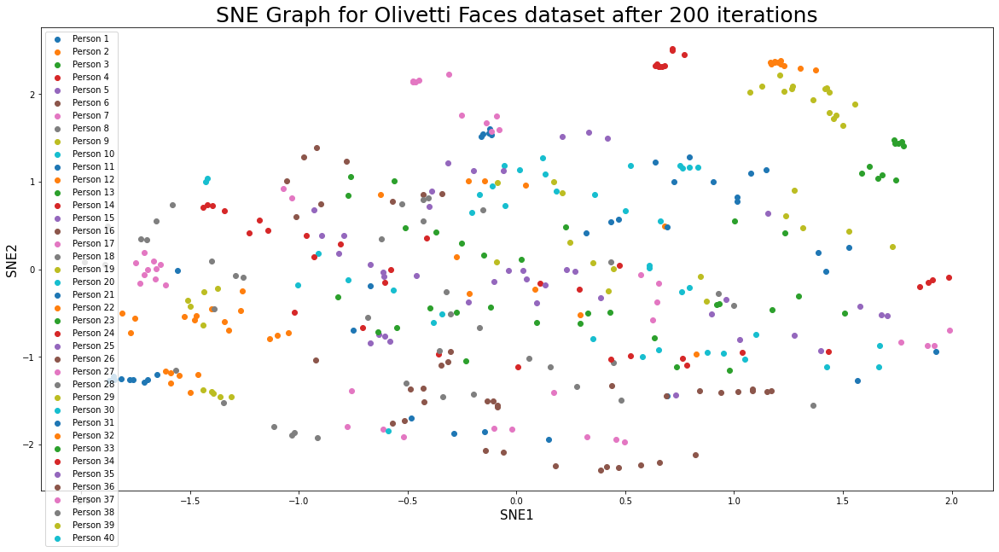

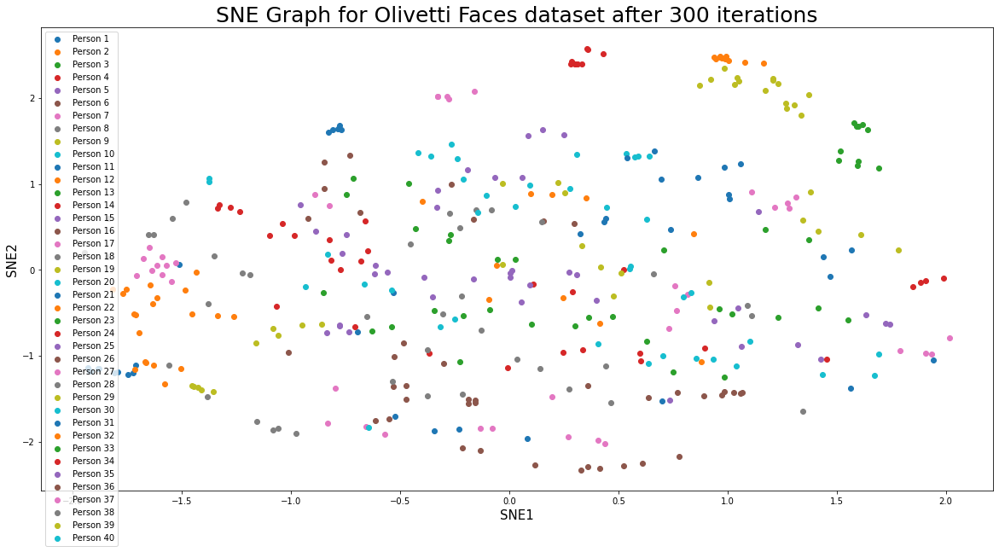

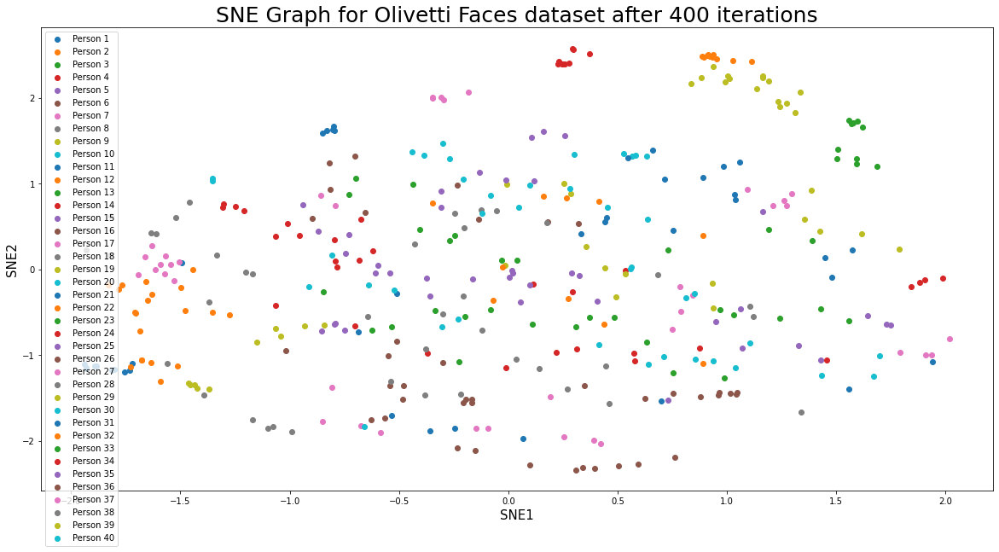

...

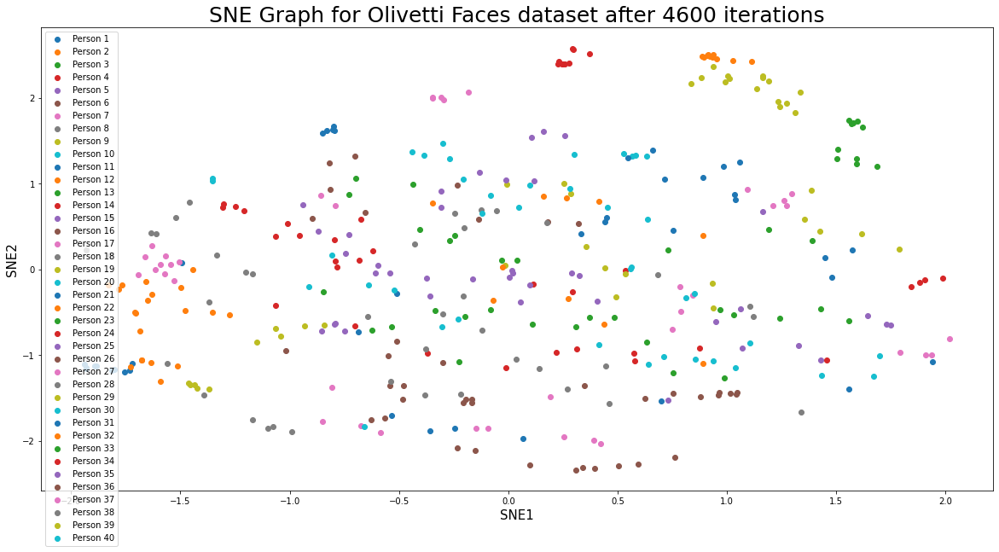

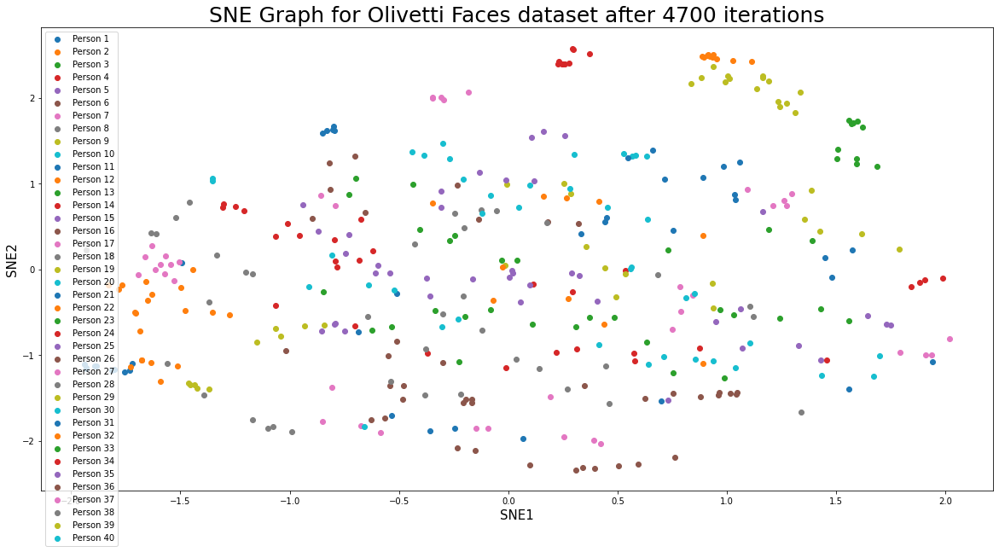

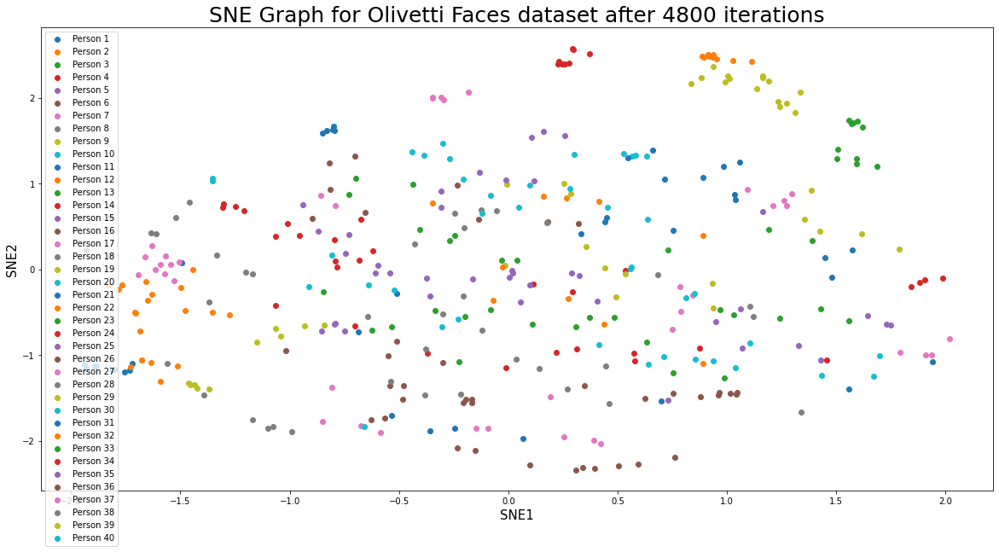

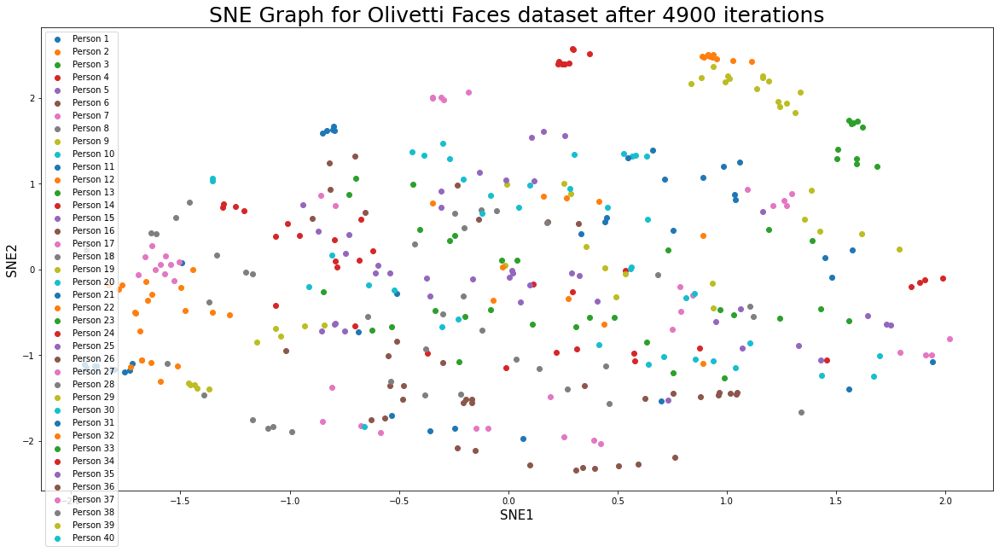

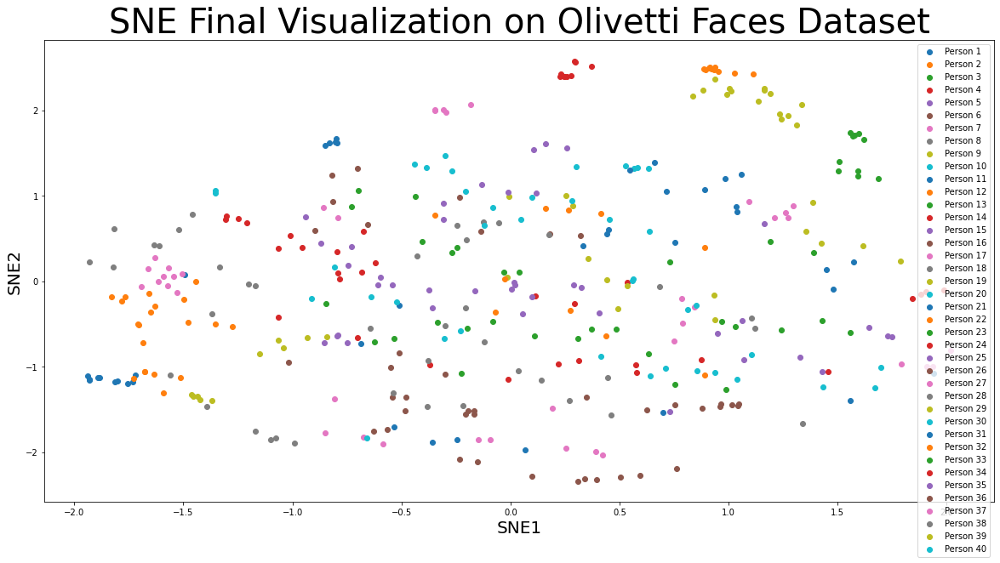

In [25]:
# OLIVETTI DATASET
x_sne_olivetti = np.copy(olivetti_x_pca)
y_sne_olivetti = np.copy(olivetti_y)

model_sne.epoch = 5000
p_sne_olivetti = model_sne.p_joint(x_sne_olivetti)

x_sne_olivetti_reduced = model_sne.fit_predict(x_sne_olivetti, y_sne_olivetti, p_sne_olivetti, rng, OLIVETTI_CLASSES, "Olivetti Faces")

graph_2d(x_sne_olivetti_reduced, y_sne_olivetti, OLIVETTI_CLASSES, "SNE", "Olivetti Faces")

## T-Distributed Stochastic Neighbouring Embedding (t-SNE)
* Purpose is to show overall converging process for and how the datapoints are visually separating
* We'll be considering Fashion MNIST and Olivetti Faces Dataset for this example

### Fashion MNIST Dataset

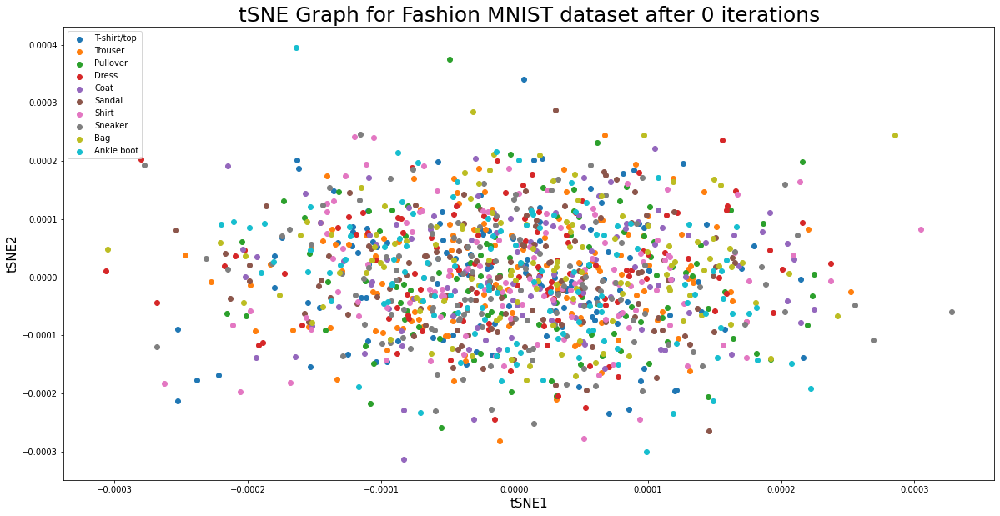

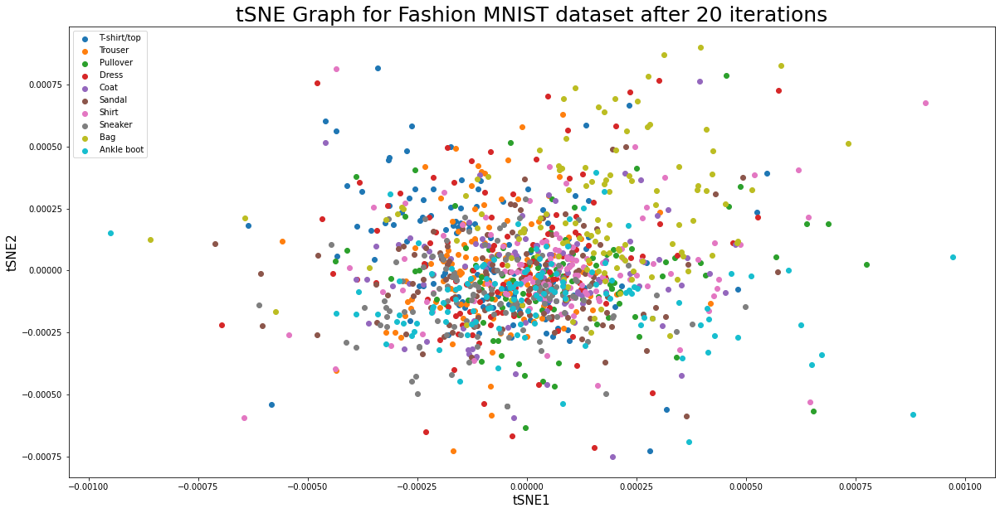

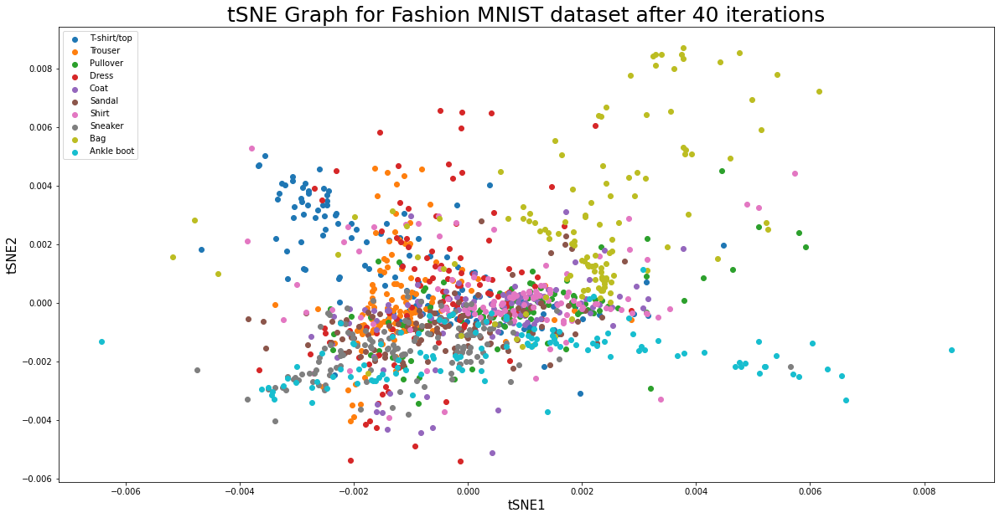

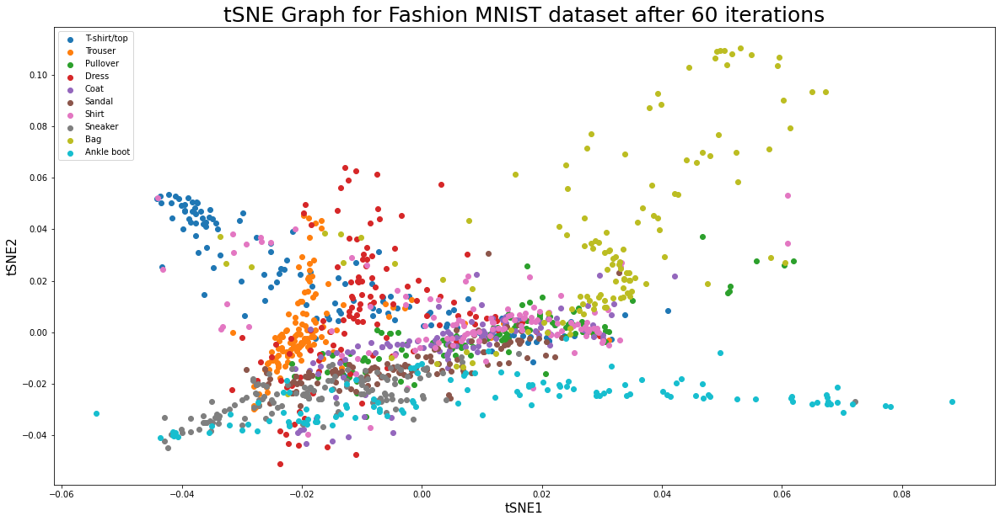

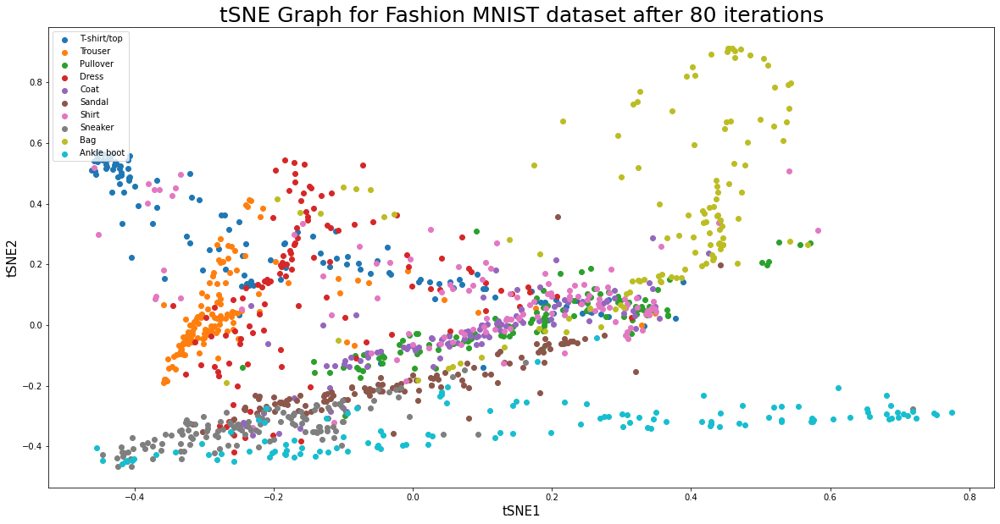

...

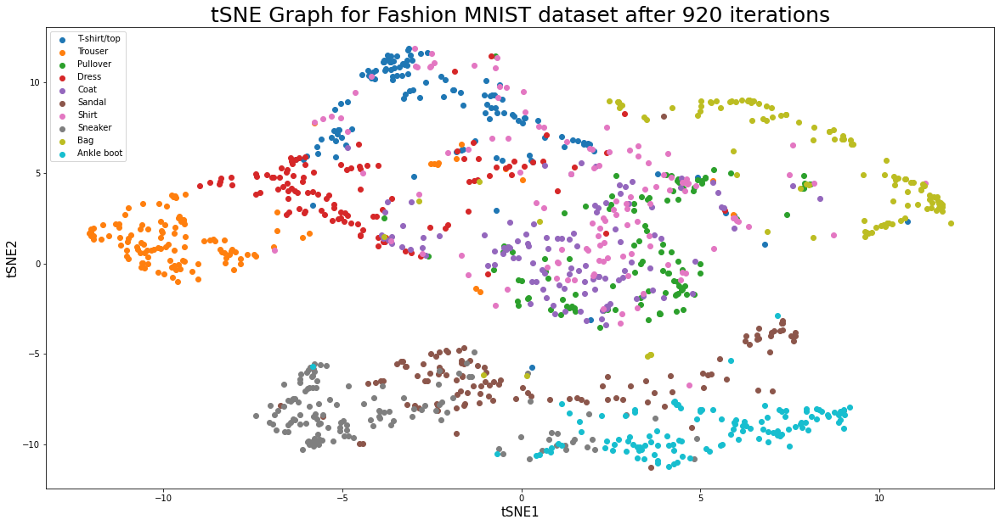

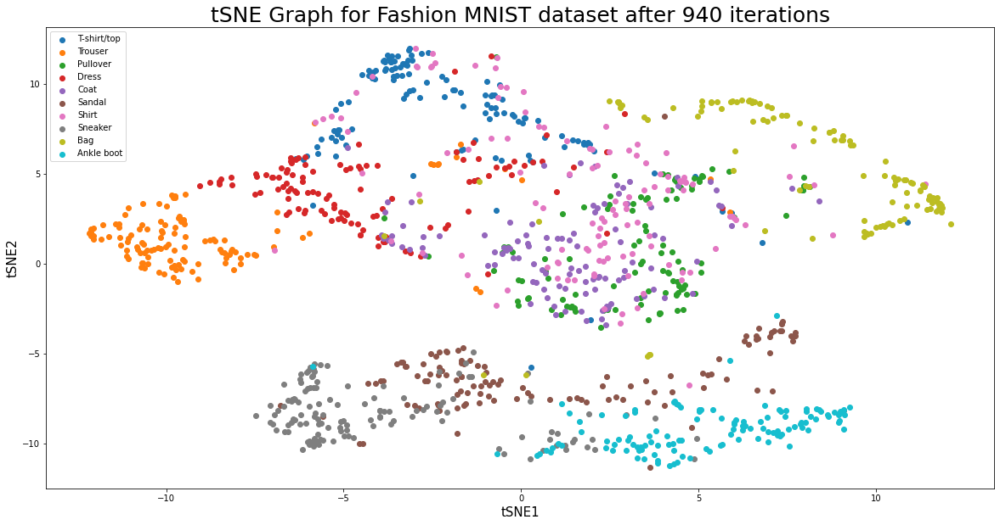

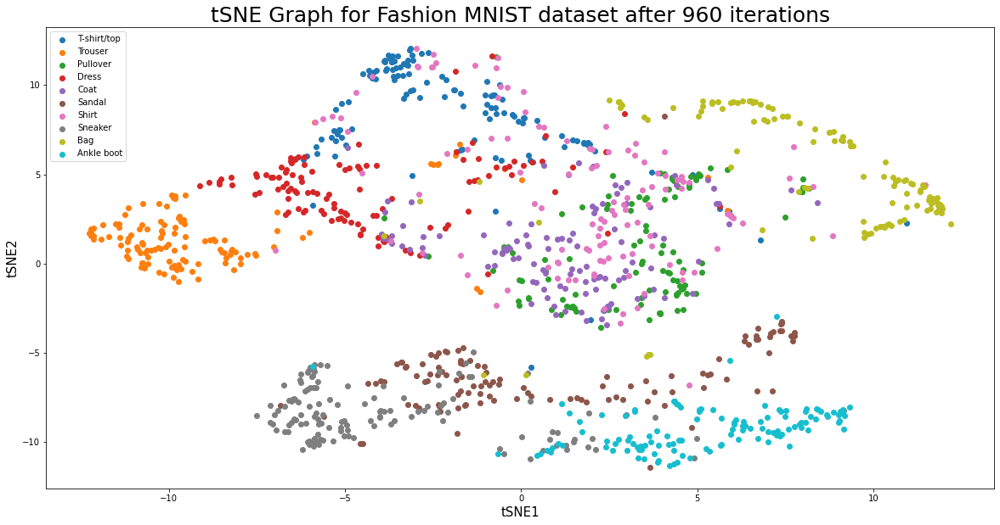

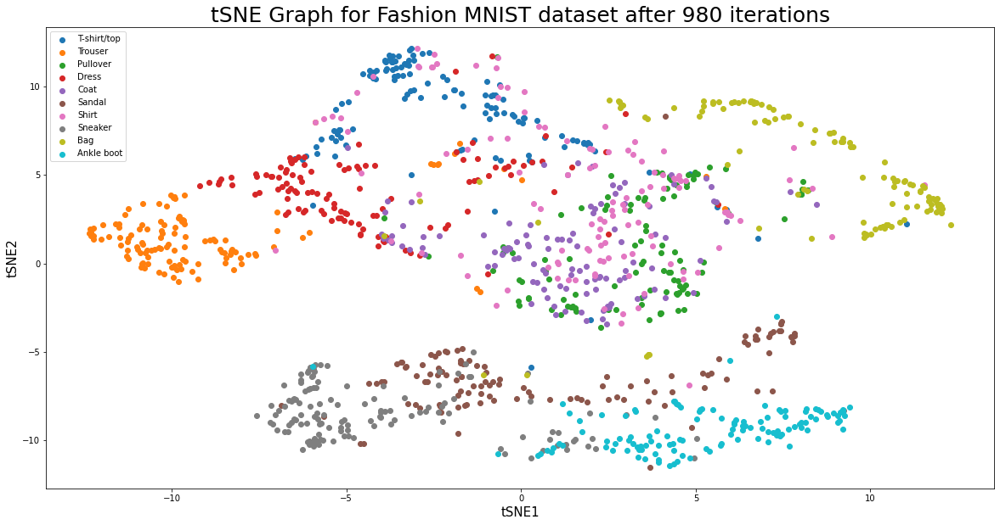

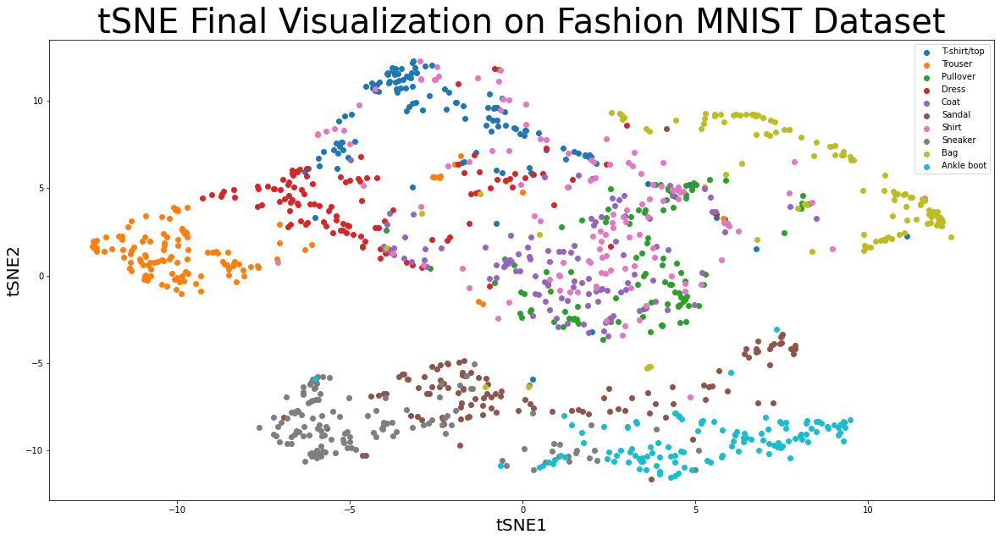

In [26]:
TSNE = True
# numpy RandomState for reproducibility
rng = np.random.RandomState(SEED)

model_tsne = SNE(PERPLEXITY, is_tsne=TSNE, num_iters=NUM_ITERS, 
            learning_rate=LEARNING_RATE, momentum=MOMENTUM,
            num_plots=NUM_PLOTS, graphing=GRAPHING, verbose=VERBOSE)

# FASHION MNIST DATASET
x_tsne_fmnist = np.copy(fashion_mnist_x_pca)
y_tsne_fmnist = np.copy(fashion_mnist_y_train)
# Obtain matrix of joint probabilities p_ij
p_tsne_fmnist = model_tsne.p_joint(x_tsne_fmnist)

x_tsne_fmnist_reduced = model_tsne.fit_predict(x_tsne_fmnist, y_tsne_fmnist, p_tsne_fmnist, rng, FASHION_MNIST_CLASSES, "Fashion MNIST")

graph_2d(x_tsne_fmnist_reduced, y_tsne_fmnist, FASHION_MNIST_CLASSES, "tSNE", "Fashion MNIST")

### Olivetti Dataset

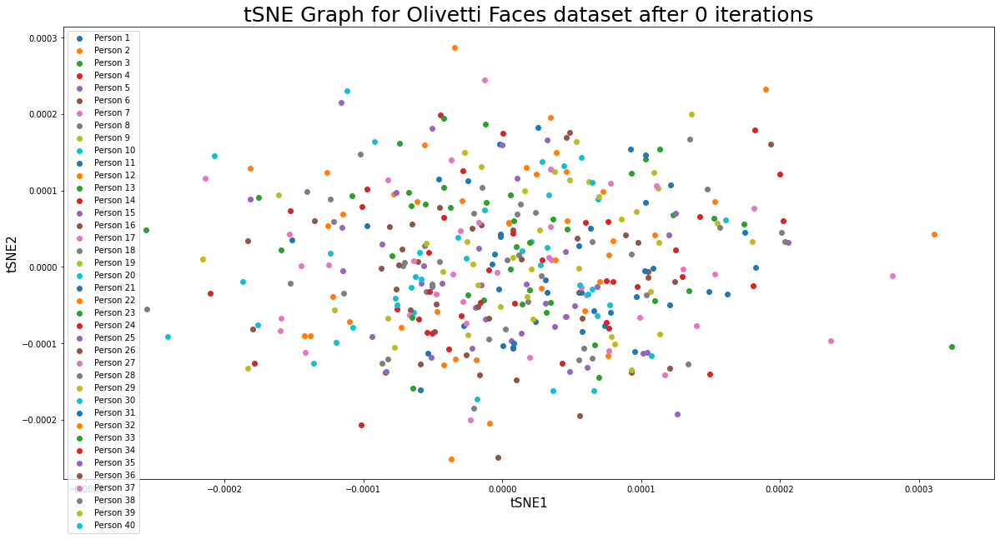

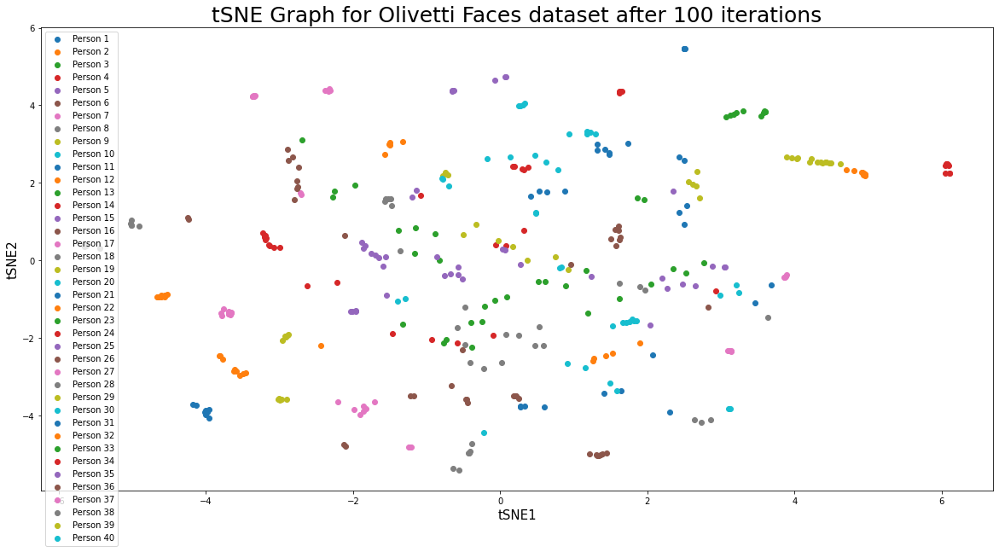

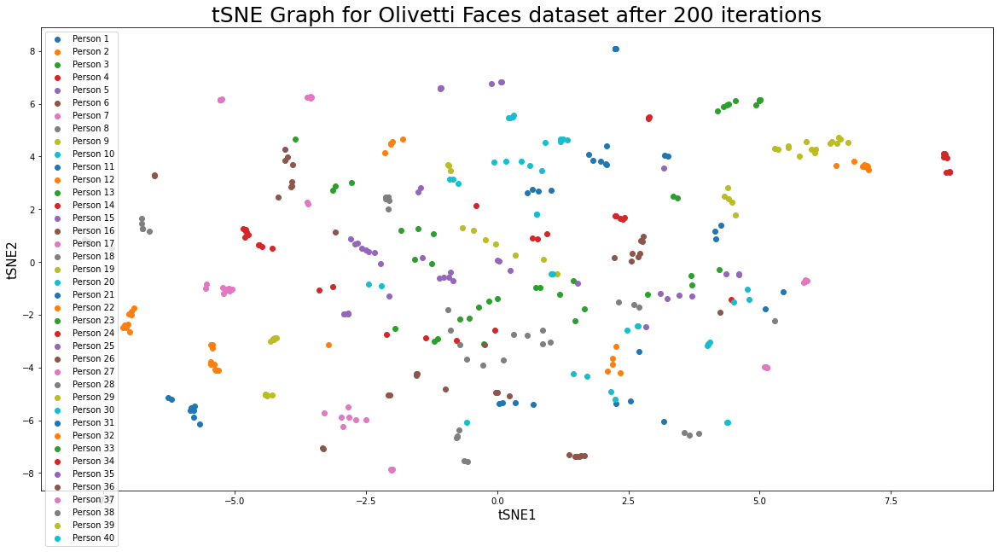

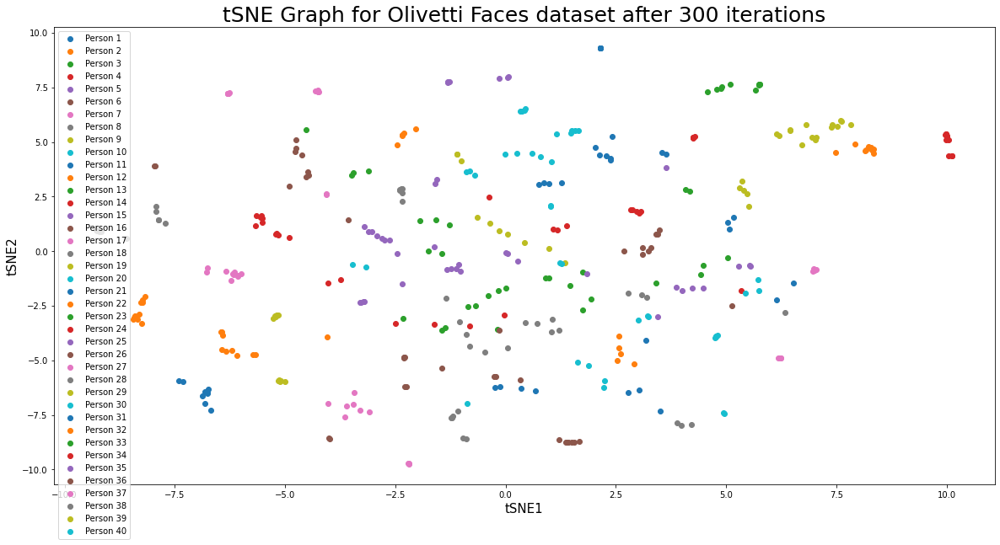

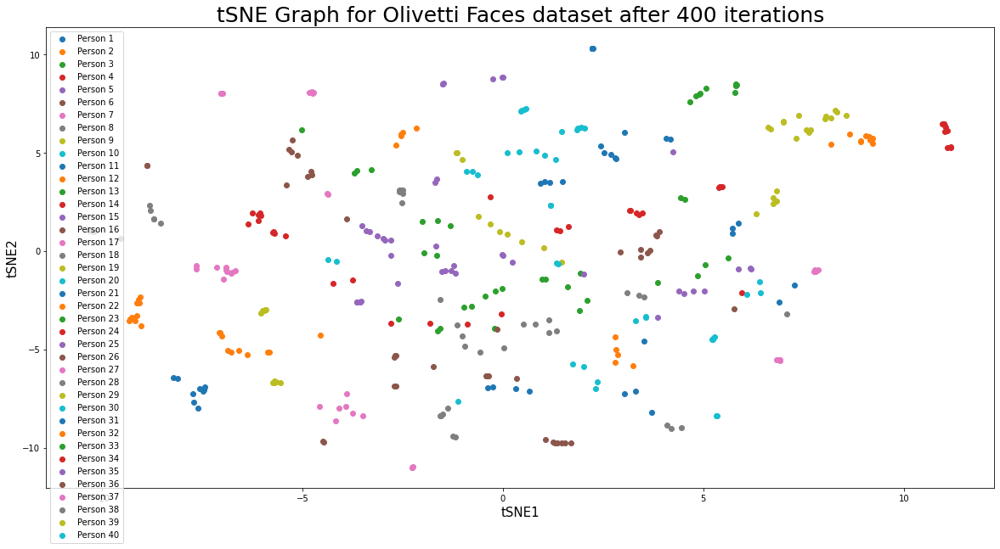

...

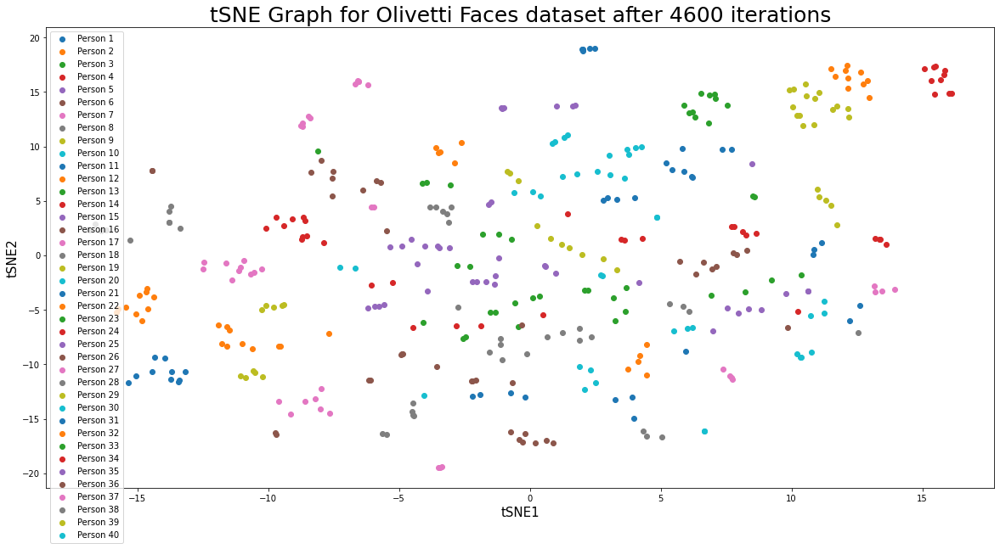

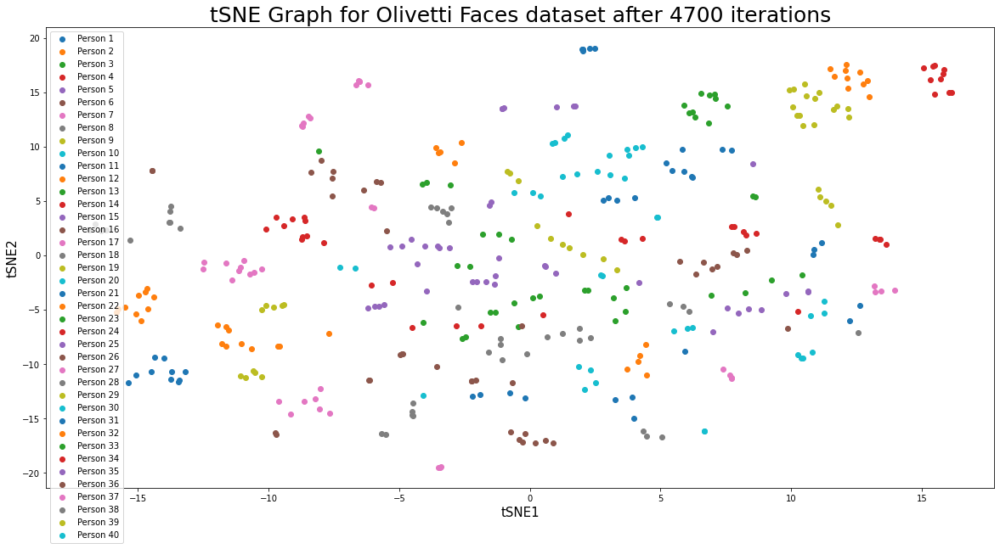

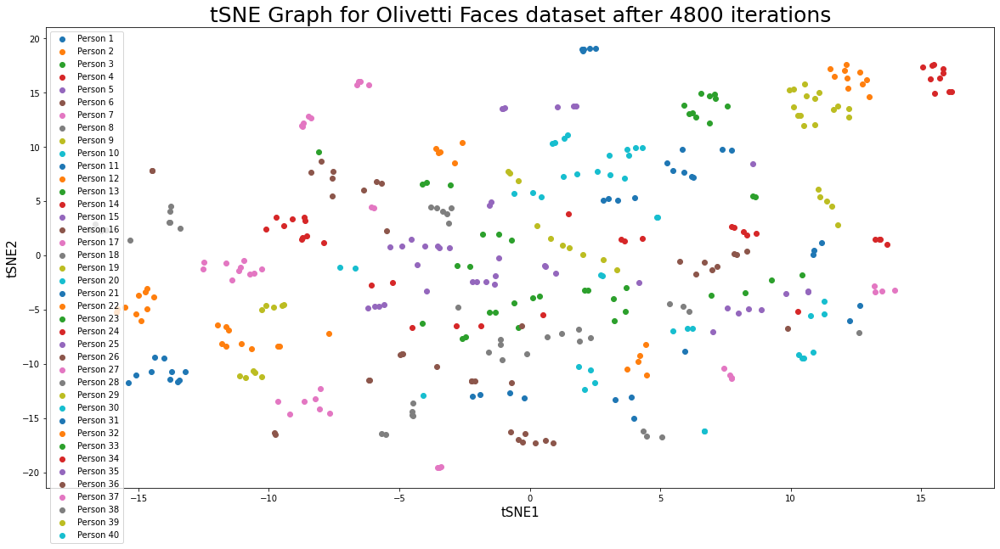

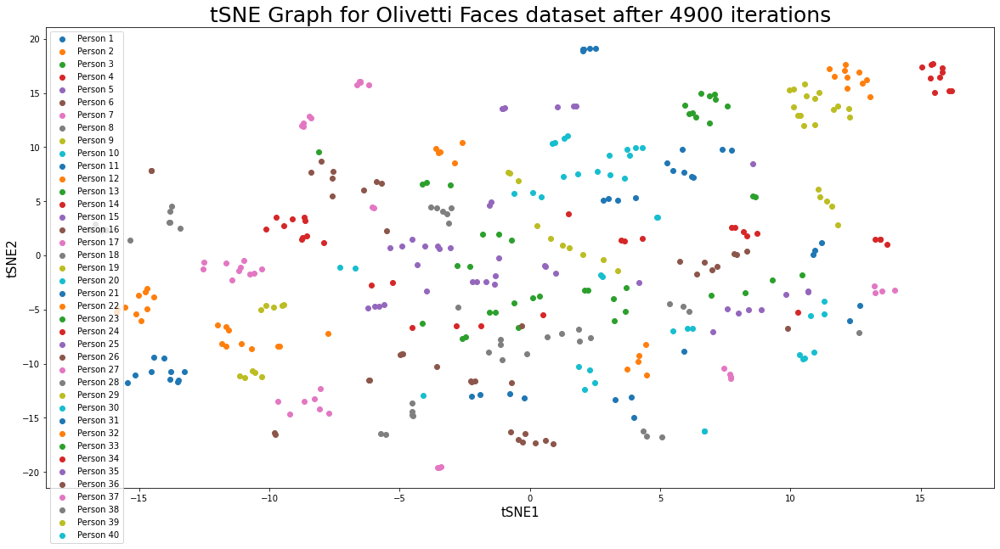

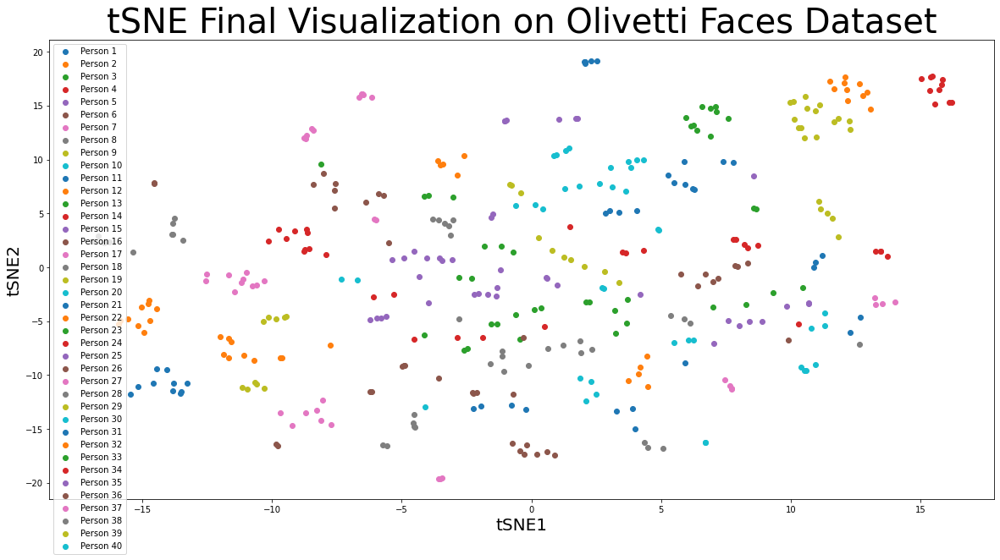

In [27]:
# OLIVETTI DATASET
x_tsne_olivetti = np.copy(olivetti_x_pca)
y_tsne_olivetti = np.copy(olivetti_y)

model_tsne.epoch = 5000
p_tsne_olivetti = model_tsne.p_joint(x_tsne_olivetti)

x_tsne_olivetti_reduced = model_tsne.fit_predict(x_tsne_olivetti, y_tsne_olivetti, p_tsne_olivetti, rng, OLIVETTI_CLASSES, "Olivetti Faces")

graph_2d(x_tsne_olivetti_reduced, y_tsne_olivetti, OLIVETTI_CLASSES, "tSNE", "Olivetti Faces")

## Using Sammon Mapping, Isomap and LLE packages to get 2D data
***
**UMAP WAS ALSO IMPLEMENTED AS AN OUT-OF-RESEARCH IMPLEMENTATION**

In [28]:
# Sammon Mapping


k=12
# Isomap
model_isomap = skmodel.Isomap(n_neighbors=k, n_components=2)

x_isomap_mnist = np.copy(mnist_x_pca)
y_isomap_mnist = np.copy(mnist_y_train)

x_isomap_fmnist = np.copy(fashion_mnist_x_pca)
y_isomap_fmnist = np.copy(fashion_mnist_y_train)

x_isomap_olivetti = np.copy(olivetti_x_pca)
y_isomap_olivetti = np.copy(olivetti_y)

# Getting 2D transformation of the datsets
x_isomap_mnist_reduced = model_isomap.fit_transform(x_isomap_mnist)
x_isomap_fmnist_reduced = model_isomap.fit_transform(x_isomap_fmnist)
x_isomap_olivetti_reduced = model_isomap.fit_transform(x_isomap_olivetti)

# LLE
# model_lle = skmodel.locally_linear_embedding(n_neighbors=k, n_components=2)
model_lle = skmodel.LocallyLinearEmbedding(n_neighbors=k, n_components=2)

x_lle_mnist = np.copy(mnist_x_pca)
y_lle_mnist = np.copy(mnist_y_train)

x_lle_fmnist = np.copy(fashion_mnist_x_pca)
y_lle_fmnist = np.copy(fashion_mnist_y_train)

x_lle_olivetti = np.copy(olivetti_x_pca)
y_lle_olivetti = np.copy(olivetti_y)

# Getting 2D transformation of the datsets
x_lle_mnist_reduced = model_lle.fit_transform(x_lle_mnist)
x_lle_fmnist_reduced = model_lle.fit_transform(x_lle_fmnist)
x_lle_olivetti_reduced = model_lle.fit_transform(x_lle_olivetti)

# UMAP
model_umap = UMAP(n_neighbors=k, n_components=2)

x_umap_mnist = np.copy(mnist_x_pca)
y_umap_mnist = np.copy(mnist_y_train)

x_umap_fmnist = np.copy(fashion_mnist_x_pca)
y_umap_fmnist = np.copy(fashion_mnist_y_train)

x_umap_olivetti = np.copy(olivetti_x_pca)
y_umap_olivetti = np.copy(olivetti_y)

# Getting 2D transformation of the datsets
x_umap_mnist_reduced = model_umap.fit_transform(x_umap_mnist)
x_umap_fmnist_reduced = model_umap.fit_transform(x_umap_fmnist)
x_umap_olivetti_reduced = model_umap.fit_transform(x_umap_olivetti)

/usr/local/lib/python3.7/dist-packages/numba/np/ufunc/parallel.py:363: NumbaWarning: The TBB threading layer requires TBB version 2019.5 or later i.e., TBB_INTERFACE_VERSION >= 11005. Found TBB_INTERFACE_VERSION = 9107. The TBB threading layer is disabled.
  warnings.warn(problem)


## Model Comparison
* tSNE vs SNE
* tSNE vs Sammon Mapping
* tSNE vs Isomap
* tSNE vs LLE
* tSNE vs UMAP **(NOT IN PAPER)**

### Comparison on MNIST Dataset

In [29]:
x_sne_mnist = np.copy(mnist_x_pca)
y_sne_mnist = np.copy(mnist_y_train)

p_sne_mnist = model_sne.p_joint(x_sne_mnist)
model_sne.epoch = 1000
model_sne.graphing = False
x_sne_mnist_reduced = model_sne.fit_predict(x_sne_mnist, y_sne_mnist, 
                                            p_sne_mnist, rng, MNIST_CLASSES, 
                                            "MNIST")

x_tsne_mnist = np.copy(fashion_mnist_x_pca)
y_tsne_mnist = np.copy(fashion_mnist_y_train)

p_tsne_mnist = model_tsne.p_joint(x_tsne_mnist)
model_tsne.epoch = 1000
model_tsne.graphing = False
x_tsne_mnist_reduced = model_tsne.fit_predict(x_tsne_mnist, y_tsne_mnist,
                                              p_tsne_mnist, rng, MNIST_CLASSES, 
                                              "MNIST")

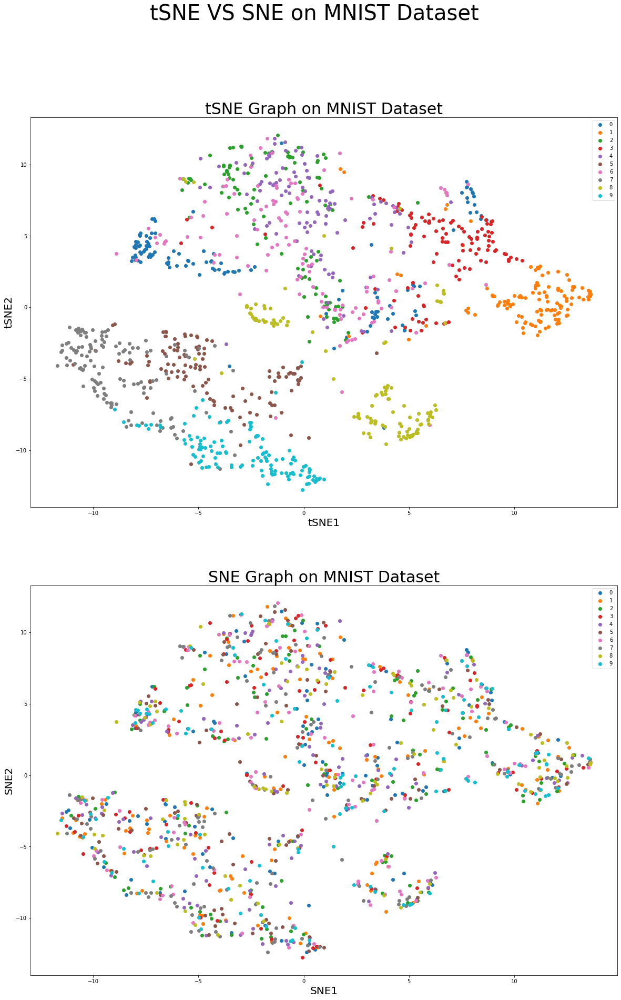

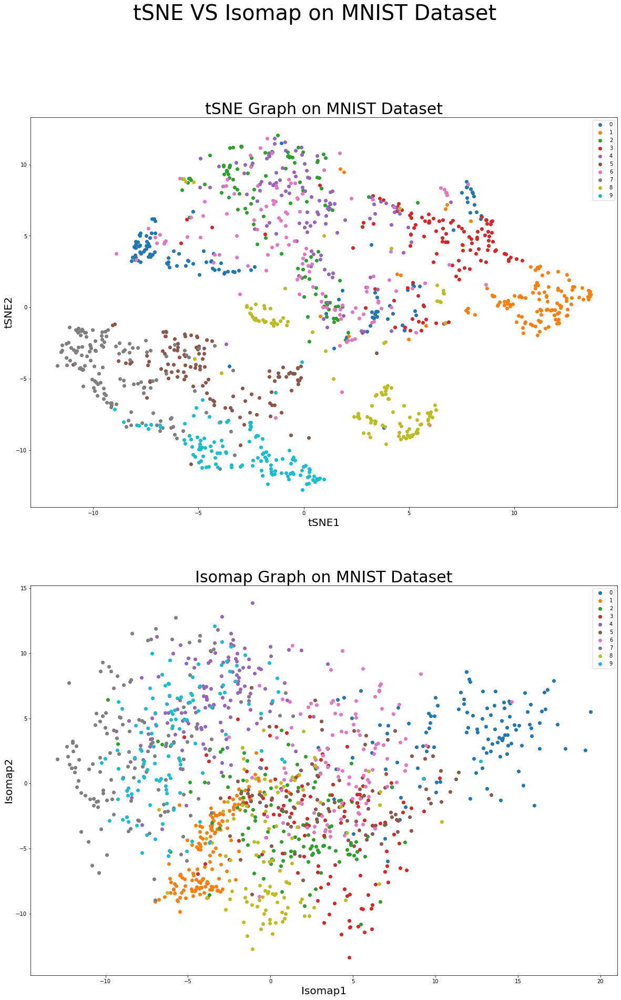

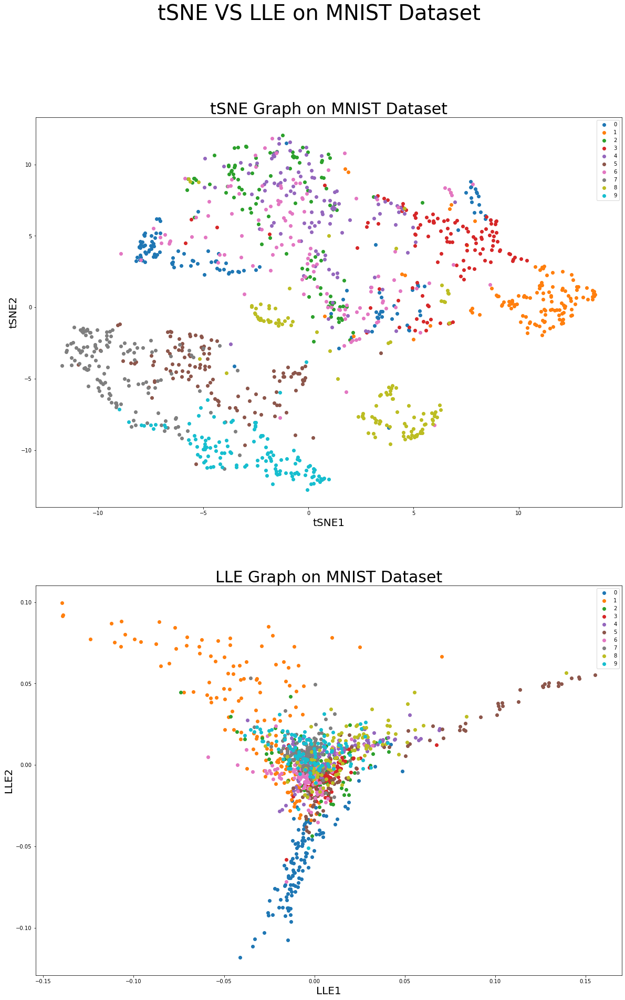

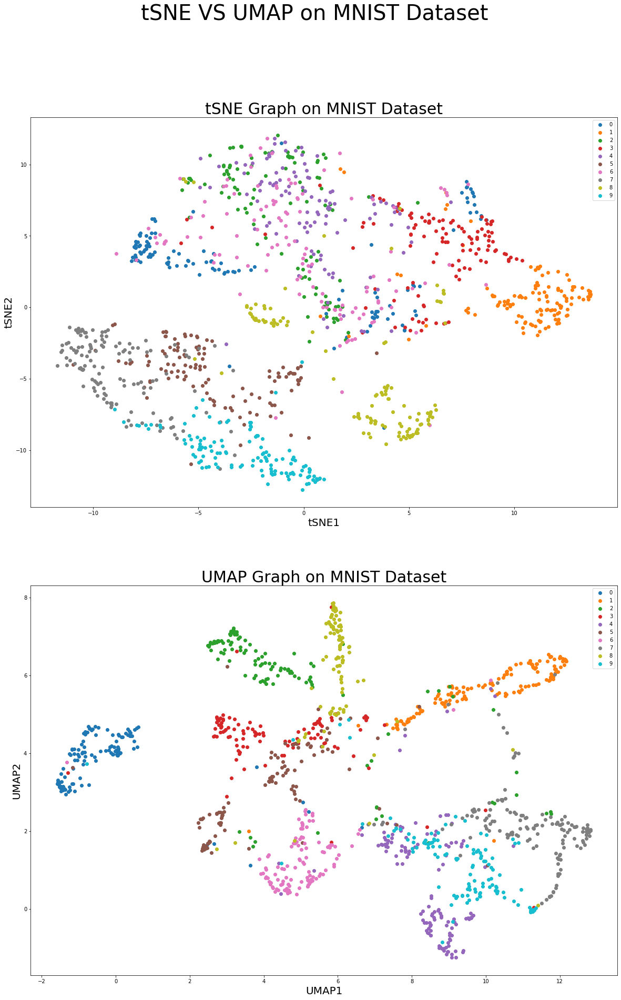

In [30]:
# tSNE vs SNE
graph_comparison(x_tsne_mnist_reduced, y_tsne_mnist, MNIST_CLASSES, "tSNE", 
                 x_tsne_mnist_reduced, y_sne_mnist, MNIST_CLASSES, "SNE", 
                 "MNIST")
print("")

# tSNE vs Isomap
graph_comparison(x_tsne_mnist_reduced, y_tsne_mnist, MNIST_CLASSES, "tSNE", 
                 x_isomap_mnist_reduced, y_isomap_mnist, MNIST_CLASSES, "Isomap", 
                 "MNIST")
print("")
# tSNE vs LLE
graph_comparison(x_tsne_mnist_reduced, y_tsne_mnist, MNIST_CLASSES, "tSNE", 
                 x_lle_mnist_reduced, y_lle_mnist, MNIST_CLASSES, "LLE", 
                 "MNIST")
print("")
#tSNE vs UMAP (EXTRAS)
graph_comparison(x_tsne_mnist_reduced, y_tsne_mnist, MNIST_CLASSES, "tSNE", 
                 x_umap_mnist_reduced, y_umap_mnist, MNIST_CLASSES, "UMAP",
                 "MNIST")

### Comparison on Fashion MNIST Dataset

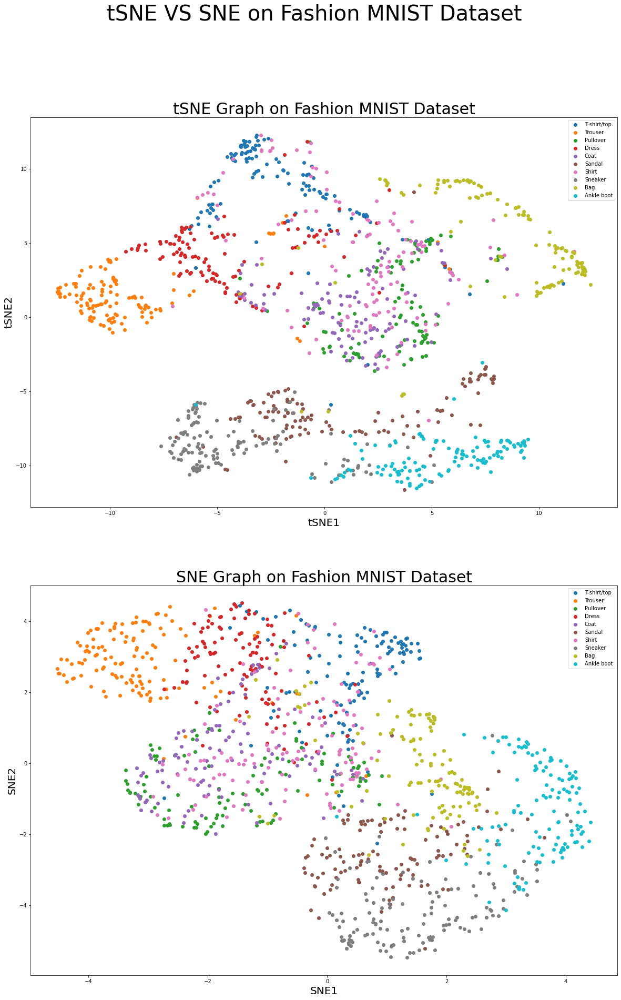

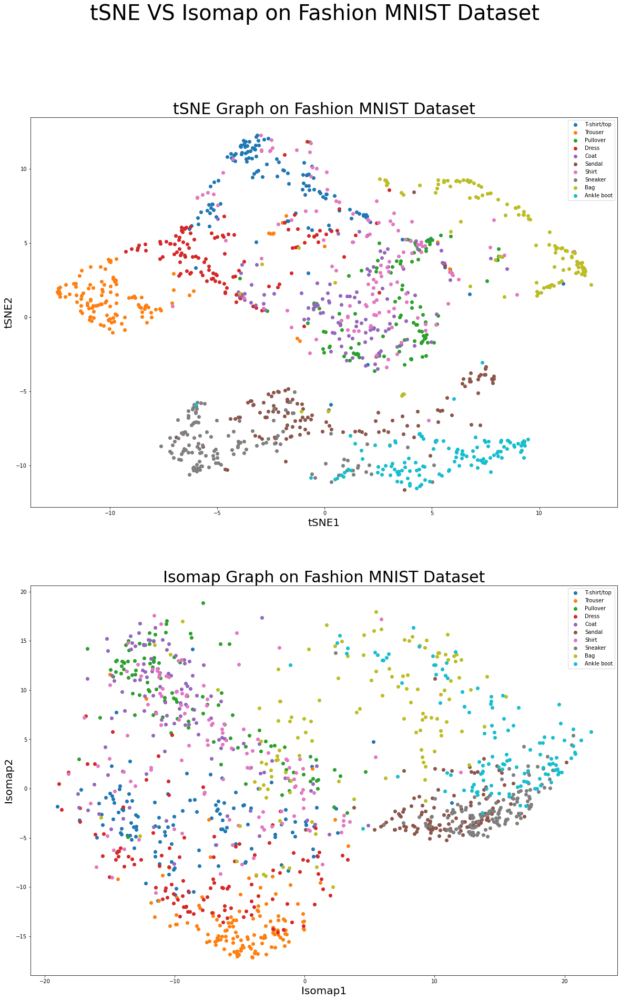

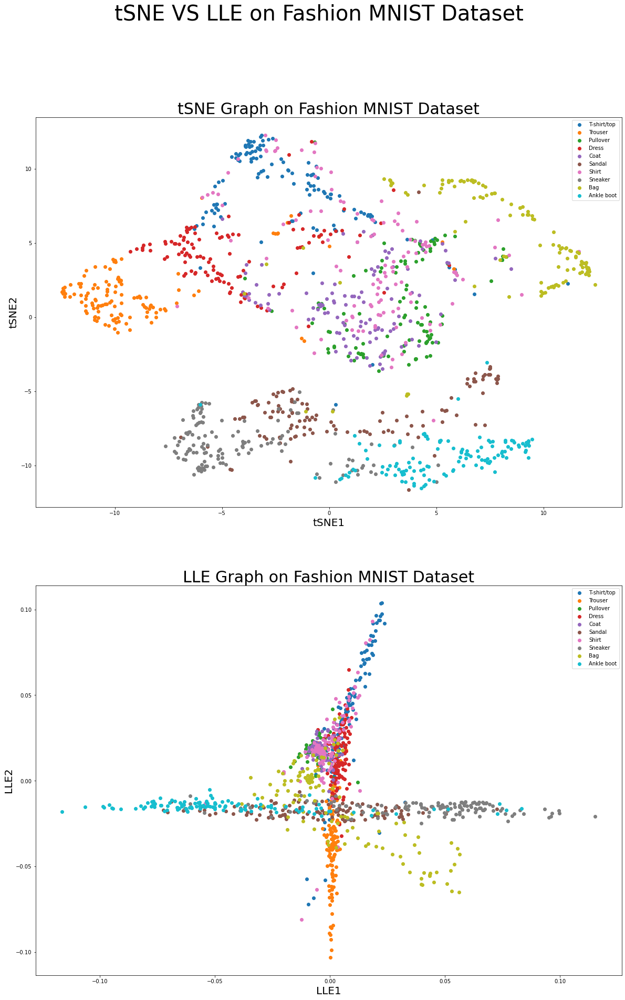

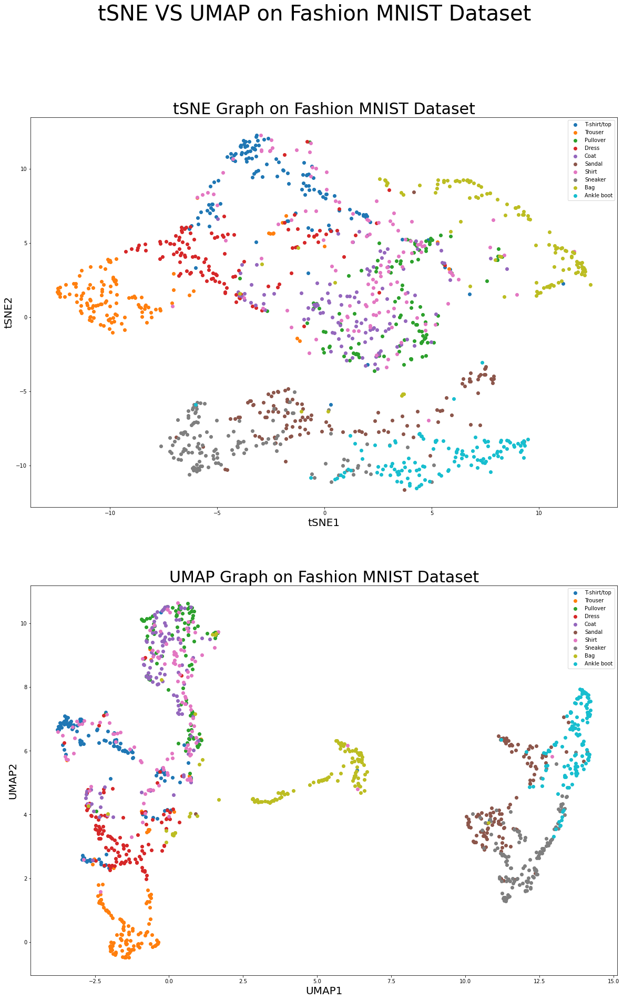

In [31]:
# tSNE vs SNE
graph_comparison(x_tsne_fmnist_reduced, y_tsne_fmnist, FASHION_MNIST_CLASSES, "tSNE", 
                 x_sne_fmnist_reduced, y_sne_fmnist, FASHION_MNIST_CLASSES, "SNE", 
                 "Fashion MNIST")
print("")

# tSNE vs Isomap
graph_comparison(x_tsne_fmnist_reduced, y_tsne_fmnist, FASHION_MNIST_CLASSES, "tSNE", 
                 x_isomap_fmnist_reduced, y_isomap_fmnist, FASHION_MNIST_CLASSES, "Isomap", 
                 "Fashion MNIST")
print("")
# tSNE vs LLE
graph_comparison(x_tsne_fmnist_reduced, y_tsne_fmnist, FASHION_MNIST_CLASSES, "tSNE", 
                 x_lle_fmnist_reduced, y_lle_fmnist, FASHION_MNIST_CLASSES, "LLE",
                 "Fashion MNIST")
print("")
#tSNE vs UMAP (EXTRAS)
graph_comparison(x_tsne_fmnist_reduced, y_tsne_fmnist, FASHION_MNIST_CLASSES, "tSNE", 
                 x_umap_fmnist_reduced, y_umap_fmnist, FASHION_MNIST_CLASSES, "UMAP", 
                 "Fashion MNIST")

### Comparison on Olivetti Faces Dataset

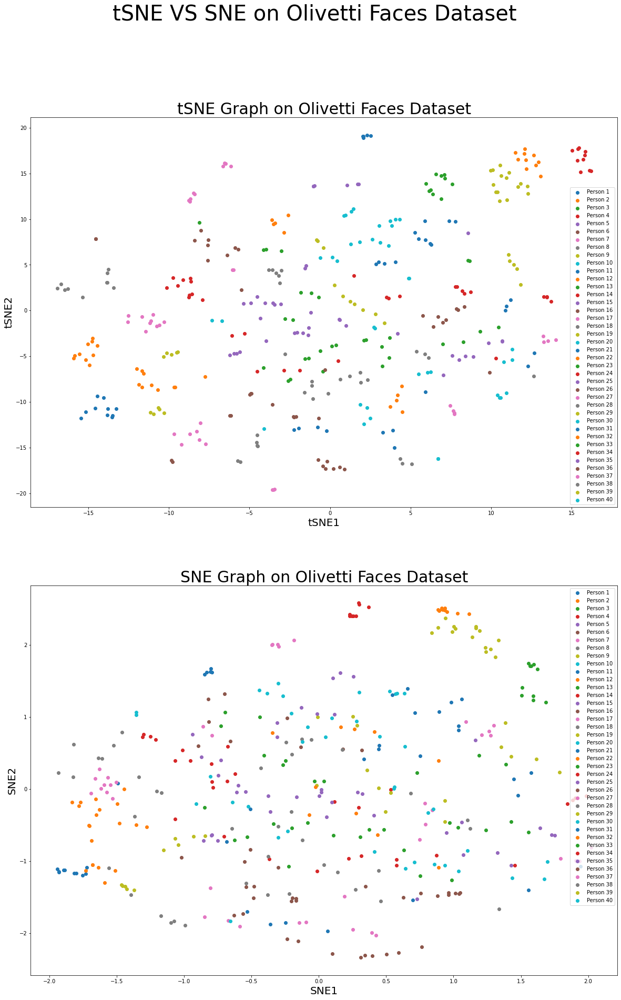

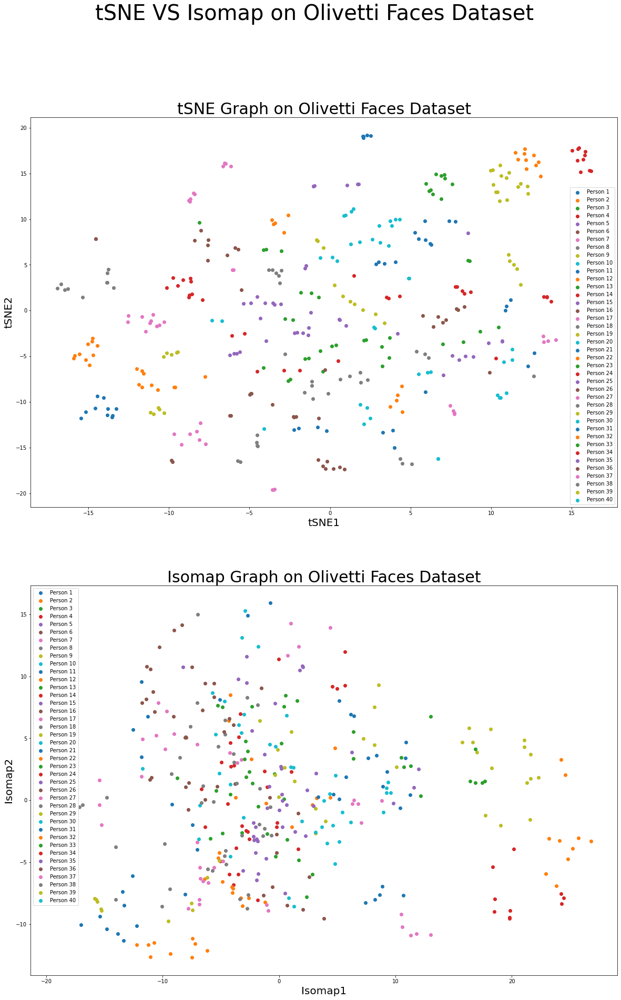

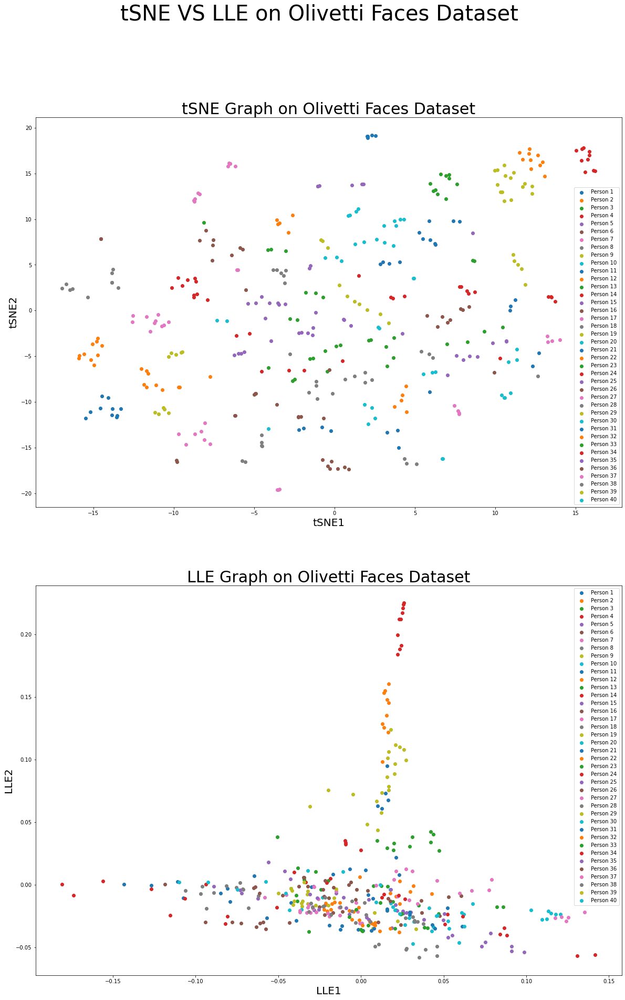

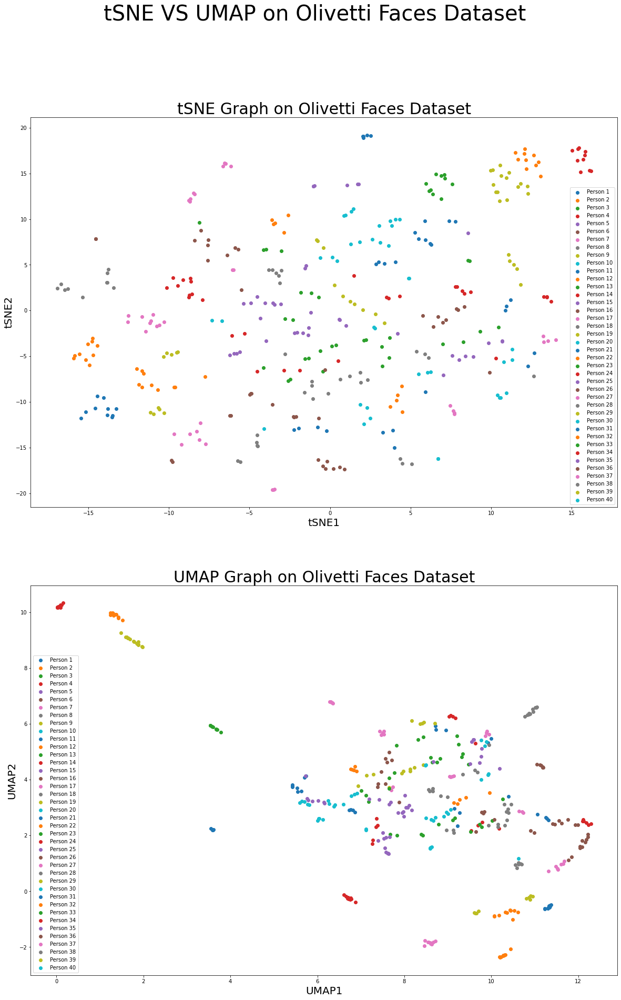

In [32]:
# tSNE vs SNE
graph_comparison(x_tsne_olivetti_reduced, y_tsne_olivetti, OLIVETTI_CLASSES, "tSNE", 
                 x_sne_olivetti_reduced, y_sne_olivetti, OLIVETTI_CLASSES, "SNE", 
                 "Olivetti Faces")
print("")

# tSNE vs Isomap
graph_comparison(x_tsne_olivetti_reduced, y_tsne_olivetti, OLIVETTI_CLASSES, "tSNE", 
                 x_isomap_olivetti_reduced, y_isomap_olivetti, OLIVETTI_CLASSES, "Isomap",
                 "Olivetti Faces")
print("")
# tSNE vs LLE
graph_comparison(x_tsne_olivetti_reduced, y_tsne_olivetti, OLIVETTI_CLASSES, "tSNE", 
                 x_lle_olivetti_reduced, y_lle_olivetti, OLIVETTI_CLASSES, "LLE", 
                 "Olivetti Faces")
print("")
#tSNE vs UMAP (EXTRAS)
graph_comparison(x_tsne_olivetti_reduced, y_tsne_olivetti, OLIVETTI_CLASSES, "tSNE", 
                 x_umap_olivetti_reduced, y_umap_olivetti, OLIVETTI_CLASSES, "UMAP", 
                 "Olivetti Faces")